In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import os
import glob
import re
import matplotlib.pyplot as plt
import sys
import seaborn as sns
from plotnine import * 

In [2]:
sys.path.insert(1, '/secure/projects/HTAPP_MBC/src/')

In [3]:
from init_phase2 import * 

In [4]:
res_dir=baseDir+"/analysis/01_annotation/"
os.makedirs(res_dir,exist_ok=True)

In [5]:
cacheName="frozen_TST"

In [12]:
de_dir=baseDir + "/differential_expression"
if not os.path.isdir(de_dir):
    os.mkdir(de_dir)

In [6]:
fpath=baseDir+"/analysis/00_stats/summary/sample_annot.tsv"
samples=pd.read_csv(fpath,"\t")
samples['raw_data'] =  dataDir+"/"+samples['sampleid']+"_10x"+"/"+samples['sampleName']+"/"+"cellbender_out_filtered.h5"
samples.head()

,ccpmID,orig.ident,sampleName,sampleid,Estimated Number of Cells,Mean Reads per Cell,Median Genes per Cell,Number of Reads,Fraction Reads in Cells,Sequencing Saturation,Reads Mapped Confidently to Genome,Reads Mapped Confidently to Transcriptome,Reads Mapped Antisense to Gene,condition,replicate,ccpm,date,Lane,Index,cancer,site,reference,flowcell,mode,mean_UMI,mean_genes,N_cells,mean_percent.mito,percent_epithelial,percent_chondrocyte,percent_epithelial_neuro,percent_epithelial_stem,percent_lymphocyte,percent_mono_macro,percent_fibroblast,percent_smooth_muscle,percent_endothelial,mean_doublet_score,percent_doublet,ccpm_id,ccpm_id_long,sample,fresh,frozen,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,raw_data
0,0200471T1,HTAPP-214-SMP-6753-TST-channel1,HTAPP-214-SMP-6753_TST_channel1,HTAPP-214-SMP-6753,433,162336,79,70291538,46.1,15.5,1.0,0.6,0.2,TST,channel1,0200471_T1_TST,2019_04_02,2,SI-GA-E1,breast,liver,GRCh38_premrna_v3.0.0,HY3H7CCXY,V3,788,611.940299,134,3.056168,69.402985,0.0,9.701493,0.0,0.000000,20.895522,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/scratch/projects/HTAPP_MBC/phase2//pipe...
1,0200471T1,HTAPP-214-SMP-6753-TST-channel2,HTAPP-214-SMP-6753_TST_channel2,HTAPP-214-SMP-6753,1595,103758,65,165494057,45.3,11.5,0.6,0.3,0.1,TST,channel2,0200471_T1_TST,2019_04_02,2,SI-GA-F1,breast,liver,GRCh38_premrna_v3.0.0,HY3H7CCXY,V3,295,194.787276,503,7.109430,77.534791,0.0,14.910537,0.0,0.000000,7.554672,0.000000,0.000000,0.000000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,/scratch/projects/HTAPP_MBC/phase2//pipe...
2,0300260T2,HTAPP-225-SMP-6756-TST-channel1,HTAPP-225-SMP-6756_TST_channel1,HTAPP-225-SMP-6756,3849,24910,1109,95881297,74.3,20.4,25.5,15.5,6.5,TST,channel1,0300260_T2_TST,2019_05_28,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,HY3CLCCXY,V3,1479,1112.339048,5716,3.086588,38.645906,0.0,0.000000,0.0,6.578027,2.081875,5.843247,8.589923,13.995801,0.025816,0.441084,260.0,300260.0,T2,False,True,IV,De novo,20740,846,846,2.0,2.0,0.95,Positive,0.70,Positive,TRUE,0.5,Positive,0.1,Positive,TRUE,Negative,Negative,TRUE,NaN,ER+/PR+/HER2-,Breast,NaN,2,Invasive lobular carcinoma,Invasive lobular carcinoma,Invasive lobular carcinoma,FALSE,/scratch/projects/HTAPP_MBC/phase2//pipe...
3,0300289T1,HTAPP-983-SMP-7659-fresh-channel1,HTAPP-983-SMP-7659_fresh_channel1,HTAPP-983-SMP-7659,1641,69313,976,113742831,39.1,44.2,82.6,45.1,1.8,fresh,channel1,0300289_T1,2019_07_25,5,SI-GA-G9,breast,liver,GRCh38_v3.0.0,H2VV5CCX2,V3,3145,737.532470,5405,69.922146,79.333950,0.0,0.000000,0.0,2.016651,8.732655,8.418131,0.000000,1.498612,0.011748,1.210654,289.0,300289.0,T1,True,False,IV,De novo,14267,1466,1466,NaN,NaN,0.8,Positive,0.95,Positive,TRUE,0.8,Positive,0.9,Positive,TRUE,Positive,Positive,TRUE,NaN,ER+/PR+/HER2+,Liver,NaN,2,Invasive ductal carcinoma with mucinous features,Mucinous features,Metastatic carcinoma,FALSE,/scratch/projects/HTAPP_MBC/phase2//pipe...
4,0300294T2,HTAPP-589-SMP-2860-TST-channel1,HTAPP-589-SMP-2860_TST_channel1,HTAPP-589-SMP-2860,6059,17913,1798,108537728,75.6,25.8,69.6,45.2,11.6,TST,channel1,0300294_T2_TST_A,2019_07_09,3,SI-GA-E5,breast,liver,GRCh38_premrna_v3.0.0,H2VTNCCX2,V3,3799,2093.743197,7239,10.780858,0.000000,0.0,0.000000,0.0,5.967675,3.660727,3.508772,0.000000,4.379058,0.082703,0.228702,294.0,300294.0,T2,False,True,IA,Recurrent,16923,2

In [8]:
#fix incorrect IDs
samples.loc[samples.ccpmID=='0200471T1','ccpmID']="0300471T1"

In [9]:
anno_detail=pd.read_excel(codeDir+"/meta/Single cell annotations4_DEIDENTIFIED_2020_9_4.xlsx")
anno_detail=anno_detail[anno_detail.htapp=='HTAPP']
anno_detail['ccpm_id_core']= '0' + anno_detail['ccpm_id_long'].astype(str)+anno_detail['sample']
anno_detail=anno_detail.merge(samples[['ccpmID','sampleid']].drop_duplicates(),left_on='ccpm_id_core', right_on='ccpmID',how="left")
anno_detail.head()

,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid
0,260.0,300260,T2,HTAPP,True,True,False,True,True,post-2019,IV,De novo,20740,846,846,2,2,0.95,Positive,0.7,Positive,True,0.5,Positive,0.1,Positive,True,Negative,Negative,True,NaN,ER+/PR+/HER2-,Breast,NaN,2,Invasive lobular carcinoma,Invasive lobular carcinoma,Invasive lobular carcinoma,False,Letrozole,19934,20259,-806,-481,Acquired resistance,Fulvestrant/Palbociclib,20276,21154,-464,414,Sensitive,GDC-9545,21173,21218,433,478,Intrinsic resistance,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300260T2,0300260T2,HTAPP-225-SMP-6756
1,289.0,300289,T1,HTAPP,True,True,True,False,True,post-2019,IV,De novo,14267,1466,1466,5,5,0.8,Positive,0.95,Positive,True,0.8,Positive,0.9,Positive,True,Positive,Positive,True,NaN,ER+/PR+/HER2+,Liver,NaN,2,Invasive ductal carcinoma with mucinous features,Mucinous features,Metastatic carcinoma,False,Olaparib,14216,14259,-51,-8,Intrinsic resistance,NaN,NaN,NaN,NaN,NaN,NaN,Trastuzumab/Capecitabine,14272,14497,5,230,Sensitive,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300289T1,0300289T1,HTAPP-983-SMP-7659
2,294.0,300294,T2,HTAPP,True,True,False,True,True,post-2019,IA,Recurrent,16923,2087,823,2,4,0.9,Positive,0.95,Positive,True,0.2,Positive,0,Negative,False,Unknown,Negative,Unknown,ER+/PR+/,ER+/PR-/HER2-,Liver,NaN,3,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,T-DM1,16125,16674,-798,-249,NaN,T-DM1/Leuprolide/Letrozole,16715,16931,-208,8,Acquired resistance,Leuprolide/Fulvestrant/Palbociclib,16932,17050,9,127,Intrinsic resistance,NaN,NaN,G442R,E454K,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0300294T2,0300294T2,HTAPP-589-SMP-2860
3,294.0,300294,T3,HTAPP,True,True,False,True,True,pre-2019,IA,Recurrent,17000,2164,900,3,5,0.9,Positive,0.3,Positive,True,0.2,Positive,0,Negative,False,Unknown,Positive,Unknown,ER+/PR+/,ER+/PR-/HER2+,Brain,NaN,3,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,Leuprolide/Fulvestrant/Palbociclib,16933,16986,-67,-14,Intrinsic resistance,Leuprolide/Fulvestrant,16932,17050,-68,50,Intrinsic resistance,Lapatinib/Capecitabine,17051,17244,51,244,Sensitive,NaN,NaN,NaN,E454K,NaN,NaN,NaN,NaN,NaN,R85_Q86insQ,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0300294T3,0300294T3,HTAPP-589-SMP-2851
4,360.0,300360,T1,HTAPP,True,True,False,True,True,post-2019,IIA,Recurrent,21662,3360,675,3,6,0.8,Positive,0.05,Low,False,0.05,Low,0,Negative,False,Negative,Negative,True,ER+/PR-low/HER2-,ER-low/PR-/HER2

In [10]:
#check for duplicates (300840 is ok because it exists as fresh and frozen)
anno_detail.loc[anno_detail.ccpm_id_core.duplicated(),:]

,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid
65,840.0,300840,T1,HTAPP,True,Pending,True,False,True,post-2019,IIIA,Recurrent,23526,3700,0,1,3,1,Positive,0.6,Positive,True,1,Positive,0,Negative,False,Negative,Negative,True,ER+/PR+/HER2-,ER+/PR-/HER2-,Liver,NaN,2,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,Letrozole,20084,23513,-3442,-13,Adjuvant,Fulvestrant,23513,23583,-13,57,UNDEFINED,Fulvestrant/Palbociclib,23527,23583,1,57,Intrinsic resistance,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300840T1,0300840T1,HTAPP-262-SMP-610


In [11]:
# read cnv data
cnv_path=baseDir+"/analysis/00_infercnv/summarized/cnv_scores_clusters.tsv"
cnv=pd.read_csv(cnv_path,"\t",low_memory=False)

In [12]:
# read subtype data
subtype_path=baseDir+"/analysis/00_subtypes/subtypes.tsv"
subtypes=pd.read_csv(subtype_path,"\t",low_memory=False)

In [13]:
# exlude HTAPP-214-SMP-6753 because failed
samples_sub=samples.loc[((samples.condition=="TST") & ([not "-iso" in i for i in samples.sampleName])& ([not "HTAPP-214-SMP-6753" in i for i in samples.sampleName])),('raw_data','sampleName')].drop_duplicates()
filenames = samples_sub['raw_data']
samplenames=samples_sub['sampleName']
md=pd.read_csv(baseDir+"analysis/00_stats/summary/all_stats_filt.tsv",sep="\t")
md=md.loc[md['pass'] == True,:]
md=md.merge(anno_detail,left_on='name', right_on='sampleid',how="left")
md=md.merge(cnv,left_on='cellid',right_on='cnv_cellid',how="left")
md=md.merge(subtypes,left_on='cellid',right_on='pam50_cellid',how="left")
md.head()

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/IPython/core/interactiveshell.py:3063: DtypeWarning: Columns (16,19,23) have mixed types.Specify dtype option on import or set low_memory=False.


,name,condition,replicate,cellid,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid,cnv_sample,cnv_cellid,cnv_cluster,cnv_cors,cnv_cors_max,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase
0,HTAPP-211-SMP-6751,TST,channel1,HTAPP-211-SMP-6751-TST-channel1_CCAATGACAGTTCA...,HTAPP-211-SMP-6751-TST-channel1,19870,7710,17.075994,23,23,Epithelial cells,0.429549,Epithelial,Epithelial cells,Epithelial,0300628_T1_TST,NaN,47,done1,NaN,2019_04_02,False,0300628_T1_TST,1,SI-GA-A1,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3H7CCXY,/transfer/190330_SL-HXZ_0566_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-211-SMP-6751_TST_channel1,True,2282,1548.0,2076.0,True,628.0,300628,T1,HTAPP,True,Pending,False,True,True,post-2019,IIB,Recurrent,16879,1100,482,NaN,NaN,0,Negative,0,Negative,True,0,Negative,0,Negative,True,Negative,Negative,True,ER-/PR-/HER2-,ER-/PR-/HER2-,Liver,NaN,3,Invasive ductal carcinoma,Invasive ductal carcinoma,Metastatic carcinoma,False,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0300628T1,0300628T1,HTAPP-211-SMP-6751,HTAPP-211-SMP-6751,HTAPP-211-SMP-6751-TST-channel1_CCAATGACAGTTCA...,Epithelial_3,0.898372,0.898372,0.016590,0.00135,12.285121,1.000000,Epithelial_3,TST,V3,0.995382,Epithelial,True,True,HTAPP-211-SMP-6751-TST-channel1_CCAATGACAGTTCA...,0.805174,0.194826,0.0,0.000000,0.000000,single,Basal,0.805174,Basal,0.66201,0.189371,0.000000,0.148619,0.000000,cluster,Basal,0.662010,Basal,0.251367,0.705318,G2M
1,HTAPP-211-SMP-6751,TST,channel1,HTAPP-211-SMP-6751-TST-channel1_ATTTCACGTTGCAT...,HTAPP-211-SMP-6751-TST-channel1,18069,7931,7.842161,23,23,Epithelial cells,0.462439,Epithelial,Epithelial cells,Epithelial,0300628_T1_TST,NaN,47,done

In [14]:
#check congruency between clinical annotation and sample annotation (should all be False)
md['ccpm_id_long'].isna().value_counts()

False    636533
Name: ccpm_id_long, dtype: int64

In [15]:
adatas=list()
for filename,samplename in zip(filenames,samplenames):
    print(samplename)
    if not samplename in filename: 
        break
    tmp=sc.read_10x_h5(filename)
    tmp.var_names_make_unique()
    tmp.obs_names=samplename.replace("_","-")+"_"+tmp.obs_names
    tmp=tmp[tmp.obs_names.isin(md.cellid)]
    tmp.shape
    adatas.append(tmp)

HTAPP-225-SMP-6756_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


HTAPP-589-SMP-2860_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-589-SMP-2860_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-589-SMP-2851_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-231-SMP-6758_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-231-SMP-6758_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-862-SMP-7059_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-862-SMP-7059_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-862-SMP-7060_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-862-SMP-7060_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-232-SMP-6759_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-232-SMP-6759_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-525-SMP-6765_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-521-SMP-6763_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-944-SMP-7479_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-944-SMP-7479_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-889-SMP-7269_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-889-SMP-7269_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-889-SMP-7270_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-889-SMP-7270_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-514-SMP-6760_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-514-SMP-6760_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-873-SMP-7119_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-873-SMP-7119_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-870-SMP-7089_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-870-SMP-7089_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-895-SMP-7359_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-895-SMP-7359_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-516-SMP-6761_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-806-SMP-6789_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-806-SMP-6789_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-963-SMP-4741_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-887-SMP-7239_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-887-SMP-7239_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-887-SMP-7250_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-213-SMP-6752_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-213-SMP-6752_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-223-SMP-6755_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-223-SMP-6755_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-223-SMP-7537_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-223-SMP-7537_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-752-SMP-4051_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-211-SMP-6751_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-211-SMP-6751_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-947-SMP-7509_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-947-SMP-7509_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-519-SMP-6762_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-878-SMP-7149_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-878-SMP-7149_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-814-SMP-6879_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-814-SMP-6879_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-880-SMP-7179_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-880-SMP-7179_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-835-SMP-6999_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-835-SMP-6999_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-226-SMP-6757_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-226-SMP-6757_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-890-SMP-7299_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-890-SMP-7299_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-262-SMP-610_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-861-SMP-7028_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-861-SMP-7028_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-997-SMP-7789_TST_channel1


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


HTAPP-997-SMP-7789_TST_channel2


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


In [16]:
%%capture
adata = adatas[0].concatenate(adatas[1:]);

In [17]:
adata.obs['cell_id']=[re.sub("-[0-9][0-9]*$","",val) for val in adata.obs.index.values]
new_obs=adata.obs.merge(md,left_on='cell_id', right_on='cellid',how="left")

In [18]:
new_obs.set_index('cellid',inplace=True)
adata.obs=new_obs

In [19]:
del adatas
sc.pp.filter_genes(adata, min_cells=3)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [20]:
adata.var['mt'] = adata.var_names.str.startswith('MT-')  # annotate the group of mitochondrial genes as 'mt'
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)

In [21]:
adata.obs.head()

,batch,cell_id,name,condition,replicate,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid,cnv_sample,cnv_cellid,cnv_cluster,cnv_cors,cnv_cors_max,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt
cellid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCTGT-1,0,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,14400,6364,2.847222,20,20,Epithelial cells,0.323041,Epithelial,Epithelial cells,Epithelial,0300260_T2_TST,NaN,65,done1,NaN,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,True,2209,1548.0,2076.0,True,260.0,300260,T2,HTAPP,True,True,False,True,True,post-2019,IV,De novo,20740,846,846,2,2,0.95,Positive,0.7,Positive,True,0.5,Positive,0.1,Positive,True,Negative,Negative,True,NaN,ER+/PR+/HER2-,Breast,NaN,2,Invasive lobular carcinoma,Invasive lobular carcinoma,Invasive lobular carcinoma,False,Letrozole,19934,20259,-806,-481,Acquired resistance,Fulvestrant/Palbociclib,20276,21154,-464,414,Sensitive,GDC-9545,21173,21218,433,478,Intrinsic resistance,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300260T2,0300260T2,HTAPP-225-SMP-6756,HTAPP-225-SMP-6756,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,Epithelial_2,0.586329,0.176141,0.002542,0.000932,2.726558,0.471278,Epithelial_1,TST,V3,0.471278,Epithelial,

In [15]:
adata.write(out_dir+"/"+cacheName+"_raw.h5ad",compression="gzip");

In [14]:
#adata=sc.read_h5ad(out_dir+"/"+cacheName+"_raw.h5ad")

In [10]:
counts = adata.X

In [11]:
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [12]:
norm = adata

In [13]:
adata.obsm["counts"] = counts
adata.raw = norm

In [14]:
del counts
del norm

In [15]:
sc.pp.highly_variable_genes(adata, min_mean=0.0125, max_mean=3, min_disp=0.5)

In [16]:
adata = adata[:, adata.var['highly_variable']]

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [17]:
%%capture
sc.pp.regress_out(adata, ['total_counts', 'pct_counts_mt']);

In [18]:
sc.pp.scale(adata, max_value=10)

In [19]:
adata.write(out_dir+"/"+cacheName+".h5ad")

In [7]:
#adata=sc.read_h5ad(out_dir+"/"+cacheName+".h5ad")

In [20]:
sc.tl.pca(adata, svd_solver='arpack')

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


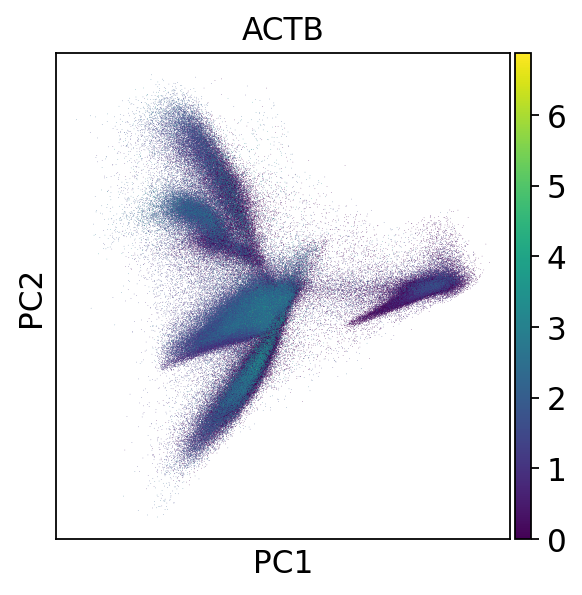

In [21]:
sc.pl.pca(adata, color='ACTB')

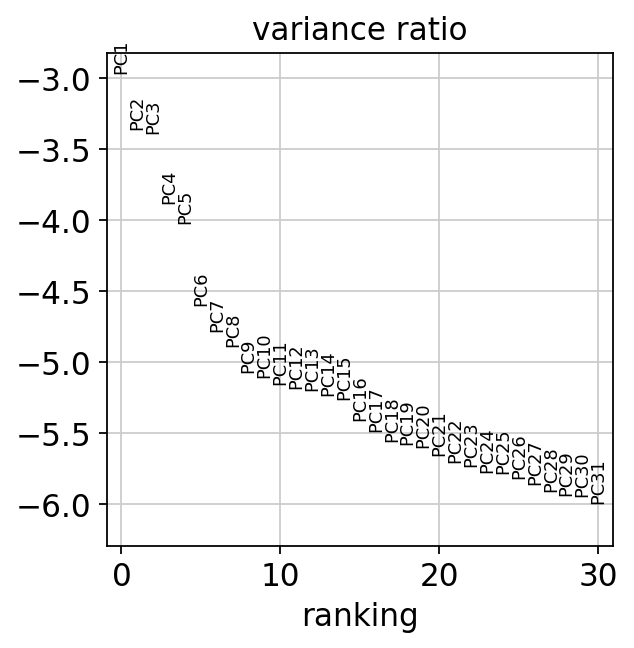

In [22]:
sc.pl.pca_variance_ratio(adata, log=True)

In [23]:
%%capture
sc.pp.neighbors(adata,random_state=42);

In [24]:
sc.tl.leiden(adata,random_state=42)

In [25]:
sc.tl.umap(adata,random_state=42)

In [13]:
%%capture
adata.write(out_dir+"/"+cacheName+".h5ad",compression="gzip")

In [8]:
adata=sc.read_h5ad(out_dir+"/"+cacheName+".h5ad")

In [238]:
#update annotation for clinical annotations (will be included automatically when adata is recreated from scratch)
#md.set_index(md.cellid,inplace=True)
#for c in md:
#    if c != 'cellid':
#        adata.obs[c]=md[c]

### Analysis - overview

In [27]:
adata.obs.head()

,batch,cell_id,name,condition,replicate,orig.ident,nCount_RNA,nFeature_RNA,percent.mito,RNA_snn_res.0.8,seurat_clusters,labels,labels_score,labels_unif,labels_cl,labels_cl_unif,ccpm,Quality,Order,run status,Note,date,run_pipeline,Channel Name,Lane,Index,cancer,site,reference,chemistry,flowcell,seq_dir,mode,min_umis,min_genes,percent_mito,expected_cells,total_droplets,z_dim,z_layers,channel_id,label_concordance,labels_cl_unif_per_channel,filt_median_genes,filt_median_umi,pass,ccpm_id,ccpm_id_long,sample,htapp,sequenced,annotated,fresh,frozen,path_tumor_present,cohort,stage_at_diagnosis,metastatic_presentation,biopsy_days_after_dob,biopsy_days_after_diagnosis,biopsy_days_after_metastasis,prior_lines_tx_metastatic,prior_lines_tx_total,ER_primary_fraction,ER_primary,ER_biopsy_fraction,ER_biopsy,ER_concordance,PR_primary_fraction,PR_primary,PR_biopsy_fraction,PR_biopsy,PR_concordance,HER2_primary,HER2_biopsy,HER2_concordance,receptors_primary,receptors_biopsy,site_biopsy,site_biopsy_detail,grade_breast,histology_breast,histology_breast2,histology_biopsy,inflammatory,tx_last_before,tx_last_before_start,tx_last_before_end,tx_last_before_start_rel,tx_last_before_end_rel,tx_last_before_response,tx_concurrent,tx_concurrent_start,tx_concurrent_end,tx_last_before_start_rel.1,tx_last_before_end_rel.1,tx_concurrent_response,tx_next_after,tx_next_after_start,tx_next_after_stop,tx_last_before_start_rel.2,tx_last_before_end_rel.2,tx_next_after_response,oncopanel_RB_CNV,oncopanel_RB_SNV,oncopanel_ESR1,oncopanel_PIK3CA,oncopanel_FOXA1,oncopanel_EGFR,oncopanel_ERBB2,oncopanel_ERBB3,oncopanel_ERBB4,oncopanel_AR,oncopanel_AURKA,oncopanel_AURKB,oncopanel_FGFR1,oncopanel_FGFR2,oncopanel_FGFR3,oncopanel_FGFR4,oncopanel_KRAS,oncopanel_HRAS,oncopanel_BRAF,oncopanel_AKT1,ccpm_id_core,ccpmID,sampleid,cnv_sample,cnv_cellid,cnv_cluster,cnv_cors,cnv_cors_max,cnv_score,cnv_ref_score,cnv_score_norm,cnv_score_norm_norm,cnv_max_cluster,cnv_condition,cnv_mode,cnv_score_norm_norm2,cnv_cell_type,cnv_pass,cnv_pass_mal,pam50_cellid,pam50_Basal_single,pam50_Her2_single,pam50_LumA_single,pam50_LumB_single,pam50_Normal_single,pam50_mode_single,pam50_subtype_single,pam50_subtype_prob_single,pam50_subtype_filt_single,pam50_Basal_cluster,pam50_Her2_cluster,pam50_LumA_cluster,pam50_LumB_cluster,pam50_Normal_cluster,pam50_mode_cluster,pam50_subtype_cluster,pam50_subtype_prob_cluster,pam50_subtype_filt_cluster,S.Score,G2M.Score,Phase,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,n_counts,leiden
cellid,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCTGT-1,0,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,HTAPP-225-SMP-6756,TST,channel1,HTAPP-225-SMP-6756-TST-channel1,14400,6364,2.847222,20,20,Epithelial cells,0.323041,Epithelial,Epithelial cells,Epithelial,0300260_T2_TST,nan,65,done1,nan,2019_05_28,False,0300260_T2_TST,5,SI-GA-C11,breast,liver,GRCh38_premrna_v3.0.0,SC3Pv3,HY3CLCCXY,/transfer/190522_SL-HYB_0503_BFC...,V3,0,0,60,4000,30000,200,1000,HTAPP-225-SMP-6756_TST_channel1,True,2209,1548.0,2076.0,True,260.0,300260,T2,HTAPP,True,True,False,True,True,post-2019,IV,De novo,20740,846,846,2,2,0.95,Positive,0.7,Positive,True,0.5,Positive,0.1,Positive,True,Negative,Negative,True,nan,ER+/PR+/HER2-,Breast,nan,2,Invasive lobular carcinoma,Invasive lobular carcinoma,Invasive lobular carcinoma,False,Letrozole,19934,20259,-806,-481,Acquired resistance,Fulvestrant/Palbociclib,20276,21154,-464,414,Sensitive,GDC-9545,21173,21218,433,478,Intrinsic resistance,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,unknown,0300260T2,0300260T2,HTAPP-225-SMP-6756,HTAPP-225-SMP-6756,HTAPP-225-SMP-6756-TST-channel1_TGCATCCAGTTGCT...,Epithelial_2,0.586329,0.176141,0.002542,0.000932,2.726558,0.471278,Epithelial_1,TST,V3,0.

In [98]:
marker_genes=["ESR1","PGR","ERBB2","KRT8","KRT18","EPCAM","ACTB","PTPRC","CD3D","CD8A","CD4","CD19" ,"CD163","CD68","LYZ","MPO","HLA-DRA","CD74","THY1","PECAM1","VWF","ICAM1","VIM","COL1A1","CYP1A1", "ABCC2", "ALB","JCHAIN","HBA1","LIPE"]

In [ ]:
#spead=1
sc.pl.umap(adata, color=marker_genes,vmax=4,ncols=5)

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['labels_cl_unif'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['name'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [12, 12]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['name'],legend_loc='on data',legend_fontweight='normal')

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['receptors_biopsy'])

In [ ]:
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['site_biopsy'],legend_fontweight='normal')

In [ ]:
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['leiden'],legend_loc='on data',legend_fontweight='normal')

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['pam50_subtype_cluster'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['Phase'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['cnv_pass_mal'])

In [ ]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['cnv_pass'])

### Analysis - cleanup labels

In [9]:
#split clusters by likey malignant or not
adata.obs['leiden_mal']=adata.obs['leiden'].astype(str)+'_'+adata.obs['cnv_pass_mal'].astype(str)

In [10]:
#cleanup cluster-label assignments (assign maximum per cluster)
adata.obs['labels_cl_unif2_mal'] = adata.obs['leiden_mal'].map(adata.obs.groupby('leiden_mal')['labels_cl_unif'].value_counts().groupby('leiden_mal').idxmax().map(lambda x: x[1]))
adata.obs['labels_cl_unif2'] = adata.obs['leiden'].map(adata.obs.groupby('leiden')['labels_cl_unif'].value_counts().groupby('leiden').idxmax().map(lambda x: x[1]))

In [11]:
mal_ct=['Epithelial','Neurons','iPS_cells']

In [12]:
ct_mal_counts=pd.DataFrame(adata.obs[['labels_cl_unif2','labels_cl_unif2_mal','cnv_pass_mal']].value_counts()).reset_index()
ct_mal_counts[((ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True")|(ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True"))].sort_values(["cnv_pass_mal",0])

,labels_cl_unif2,labels_cl_unif2_mal,cnv_pass_mal,0
46,Epithelial,B,False,2
44,Epithelial,Erythrocytes,False,4
43,Epithelial,Endothelial,False,5
40,Epithelial,Skeletal muscle,False,9
36,Epithelial,Macrophage,False,26
35,Neurons,Smooth muscle,False,27
31,Neurons,Neurons,False,78
29,Neurons,Macrophage,False,102
28,Epithelial,CD4+ T-cells,False,152
27,Epithelial,Smooth muscle,False,154


/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'leiden_mal' as categorical
... storing 'labels_cl_unif2_mal' as categorical
... storing 'labels_cl_unif2' as categorical


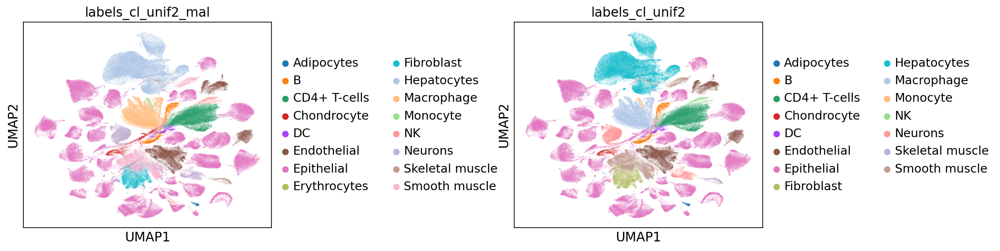

In [13]:
sc.pl.umap(adata, color=['labels_cl_unif2_mal','labels_cl_unif2'],legend_fontweight='normal',wspace=0.8)

#### Check "normal" cell types with positiv cnv status 

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


<AxesSubplot:title={'center':'labels_cl_unif2_mal'}, xlabel='UMAP1', ylabel='UMAP2'>

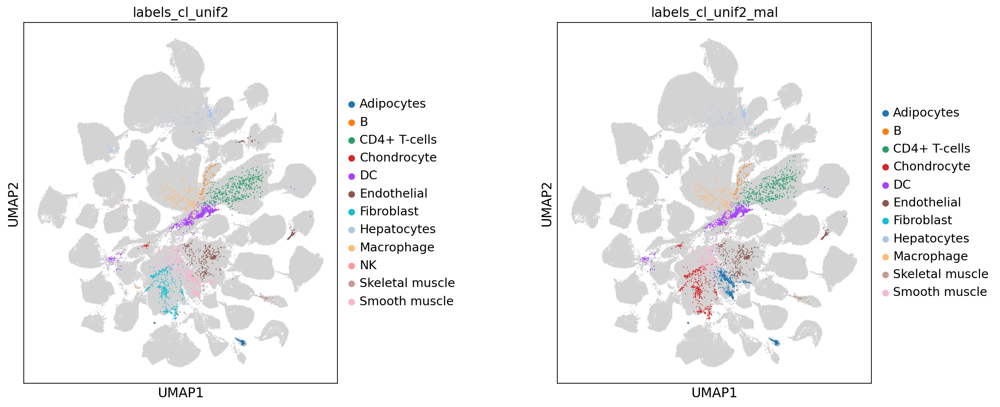

In [18]:
# plot normal cell types that have a positve cnv score
colors=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')].obs["labels_cl_unif2"].dtype.categories]
colors_mal=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[~(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')].obs["labels_cl_unif2_mal"].dtype.categories]
fig, axs = plt.subplots(1,2,figsize=(16,7),gridspec_kw={'wspace':0.7})
sc.pl.umap(adata, size=5, show=False, ax=axs[0])
sc.pl.umap(adata[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')], color=['labels_cl_unif2'],legend_fontweight='normal',ax=axs[0],size=5, show=False,palette=colors.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[1])
sc.pl.umap(adata[~(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')], color=['labels_cl_unif2_mal'],legend_fontweight='normal',ax=axs[1],size=5, show=False,palette=colors_mal.values.tolist())

In [19]:
adata.obs.loc[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')][['name','labels_cl_unif']].value_counts().head(n=20)

name                labels_cl_unif
HTAPP-231-SMP-6758  DC                332
HTAPP-862-SMP-7059  Chondrocyte       186
HTAPP-806-SMP-6789  Adipocytes        152
HTAPP-232-SMP-6759  Hepatocytes       143
HTAPP-223-SMP-6755  CD4+ T-cells      116
HTAPP-225-SMP-6756  Adipocytes        116
HTAPP-862-SMP-7060  CD4+ T-cells      109
HTAPP-226-SMP-6757  CD4+ T-cells       94
HTAPP-890-SMP-7299  Smooth muscle      78
HTAPP-944-SMP-7479  Endothelial        77
HTAPP-231-SMP-6758  CD8+ T-cells       66
HTAPP-878-SMP-7149  Chondrocyte        64
HTAPP-211-SMP-6751  Epithelial         57
HTAPP-231-SMP-6758  CD4+ T-cells       57
HTAPP-862-SMP-7060  Fibroblast         52
HTAPP-223-SMP-6755  Hepatocytes        40
HTAPP-226-SMP-6757  Epithelial         40
HTAPP-231-SMP-6758  Smooth muscle      39
HTAPP-887-SMP-7239  Epithelial         37
HTAPP-878-SMP-7149  Epithelial         36
dtype: int64

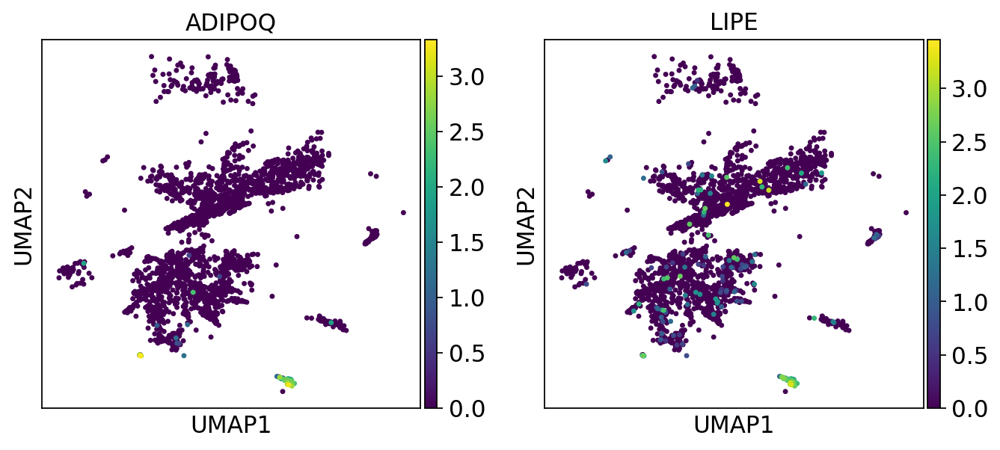

In [16]:
plt.rcParams['figure.figsize'] = [4, 4]
sc.pl.umap(adata[~(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')], color=['ADIPOQ','LIPE'],legend_fontweight='normal')

In [129]:
mix_counts=pd.DataFrame(adata.obs[~(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='True')][["labels_cl_unif2_mal","labels_cl_unif2"]].value_counts()).reset_index()
mix_counts[(mix_counts['labels_cl_unif2_mal'].astype(str)!=mix_counts['labels_cl_unif2'].astype(str))]

,labels_cl_unif2_mal,labels_cl_unif2,0
2,Adipocytes,Smooth muscle,382
3,Chondrocyte,Fibroblast,373
8,Epithelial,Hepatocytes,88
12,Epithelial,Endothelial,24
13,Epithelial,Macrophage,20
15,CD4+ T-cells,NK,8
16,Epithelial,CD4+ T-cells,5
17,Fibroblast,Smooth muscle,4


#### Check malignant cell types without CNVs (especially relevant in breast biopsies, where there might be normal breast epithelial cells

Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.
Trying to set attribute `.uns` of view, copying.


<AxesSubplot:title={'center':'labels_cl_unif2'}, xlabel='UMAP1', ylabel='UMAP2'>

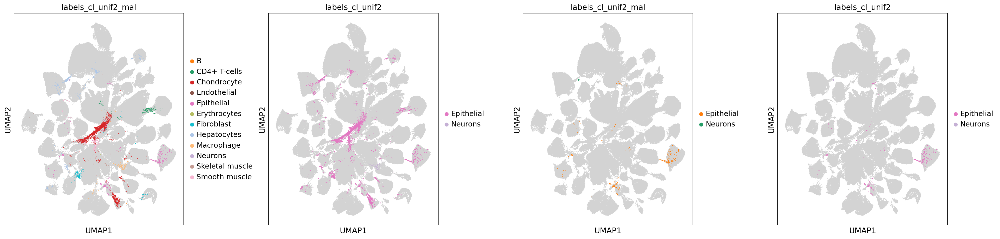

In [31]:
# plot malignant cell types that have a negative cnv score
colors=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')].obs["labels_cl_unif2_mal"].dtype.categories]
colors_mal=pd.Series(adata.uns["labels_cl_unif2_mal_colors"],index=adata.obs["labels_cl_unif2_mal"].dtype.categories)[adata[(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')].obs["labels_cl_unif2"].dtype.categories]
fig, axs = plt.subplots(1,4,figsize=(30,7),gridspec_kw={'wspace':0.5})
sc.pl.umap(adata, size=5, show=False, ax=axs[0])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2_mal'],legend_fontweight='normal',ax=axs[0],size=5, show=False,palette=colors.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[1])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2'],legend_fontweight='normal',ax=axs[1],size=5, show=False,palette=colors_mal.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[2])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2_mal'],legend_fontweight='normal',ax=axs[2],size=5, show=False,palette=colors.values.tolist())
sc.pl.umap(adata, size=5, show=False, ax=axs[3])
sc.pl.umap(adata[(adata.obs.labels_cl_unif2_mal.isin(mal_ct))&(adata.obs.cnv_pass_mal=='False')], color=['labels_cl_unif2'],legend_fontweight='normal',ax=axs[3],size=5, show=False,palette=colors_mal.values.tolist())

In [69]:
# check cluster composiotion and cnv_score to sprcifically check for potential "healthy" epithelial cells
md_epithelial=adata.obs[adata.obs['labels_cl_unif2'].isin(mal_ct)].copy()
md_epithelial['name']=pd.Categorical(md_epithelial['name'], categories=md_epithelial.groupby('name').mean('cnv_score').sort_values('cnv_score').index.tolist())

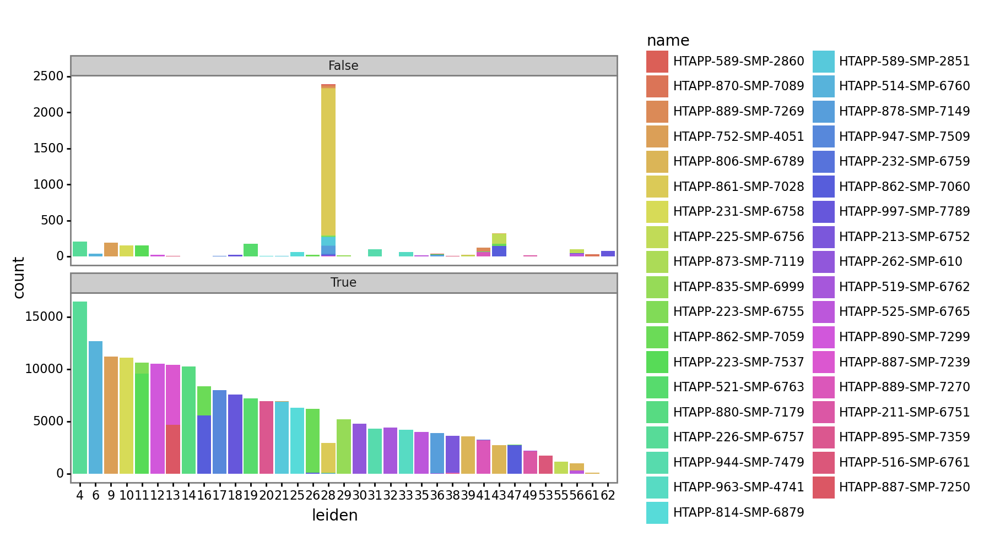

<ggplot: (-9223369061478475674)>

In [74]:
ggplot(md_epithelial,aes(x='leiden',fill='name'))+geom_bar()+facet_wrap('cnv_pass_mal',ncol=1,scales="free_y")

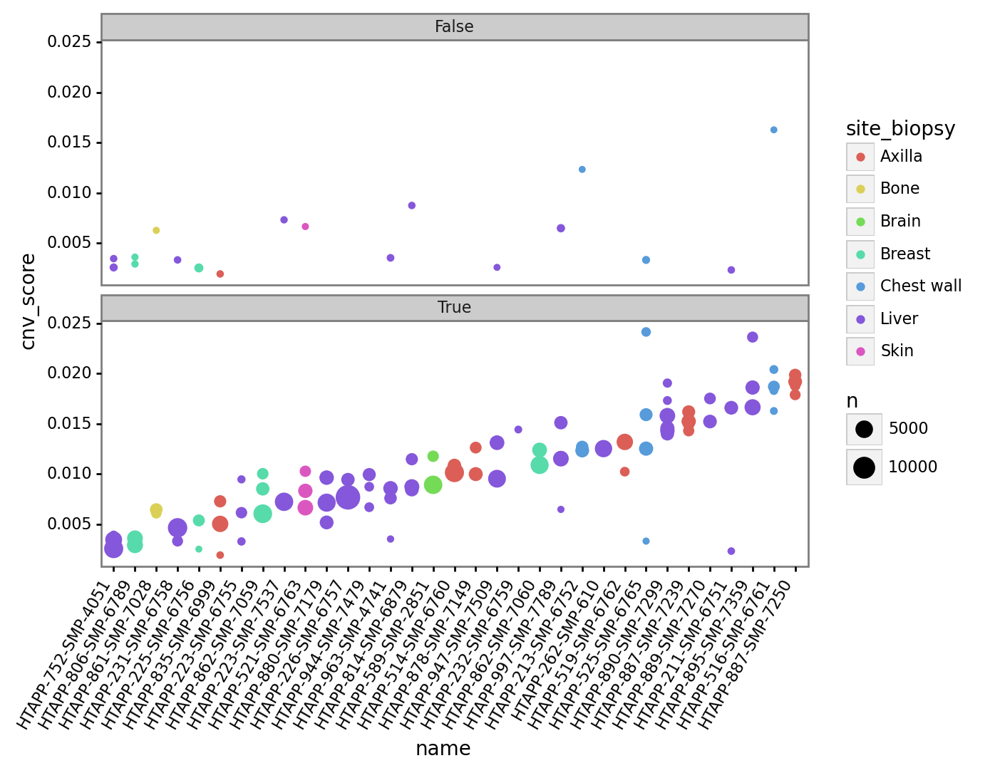

<ggplot: (2975372424638)>

In [71]:
ggplot(md_epithelial[md_epithelial.cnv_cell_type.isin(mal_ct)],aes(x='name',y='cnv_score',color='site_biopsy'))+geom_count()+rotate_labels()+facet_wrap('cnv_pass_mal',ncol=1)

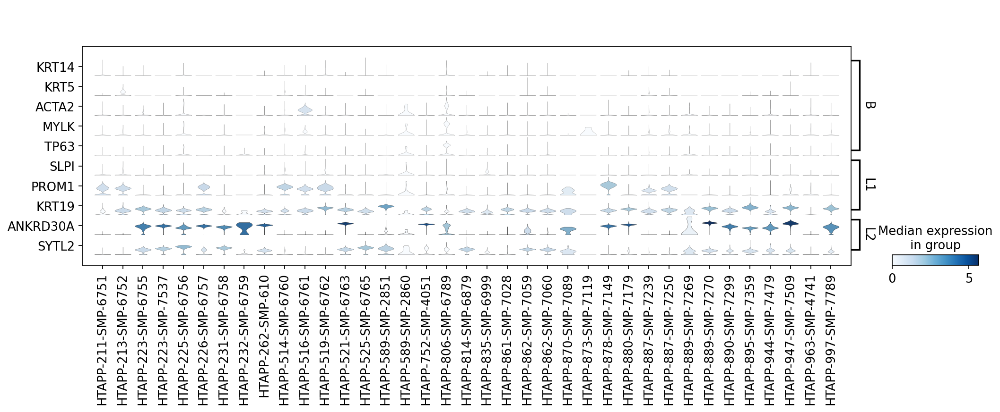

In [82]:
# check expression of genes that characterize normal breast epithelial cells (no guarantee that they are not expressed in malignant, though)
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.stacked_violin(adata[adata.obs['labels_cl_unif2'].isin(mal_ct)], groupby='name',
                     var_names={"B":['KRT14','KRT5','ACTA2','MYLK','TP63'],"L1":['SLPI','PROM1','KRT19'],"L2":["ANKRD30A","SYTL2"]},swap_axes=True,)

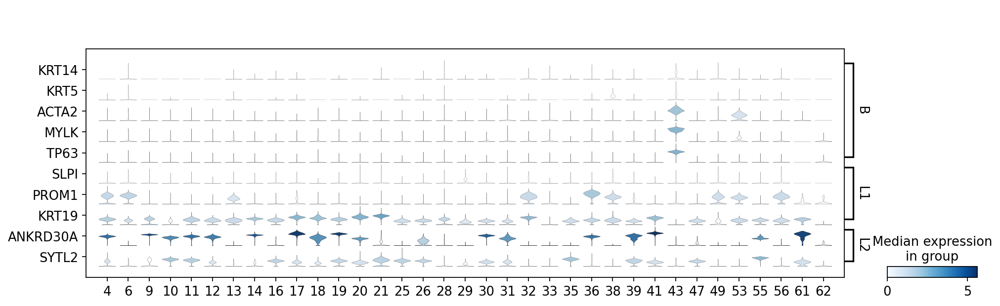

In [83]:
# check expression of genes that characterize normal breast epithelial cells (no guarantee that they are not expressed in malignant, though)
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.stacked_violin(adata[adata.obs['labels_cl_unif2'].isin(mal_ct)], groupby='leiden',
                     var_names={"B":['KRT14','KRT5','ACTA2','MYLK','TP63'],"L1":['SLPI','PROM1','KRT19'],"L2":["ANKRD30A","SYTL2"]},swap_axes=True,)

In [ ]:
#Including malignancy calls didn't recover any additional interesting population --> continue without taking it into account
#### Continue renaming and filtering with "labels_cl_unif2"

In [132]:
#unify some annotation
adata.obs['labels_cl_unif2_broad']=adata.obs['labels_cl_unif2'].map(lambda x: "T" if x in ["CD8+ T-cells","CD4+ T-cells"] else 
                                                                   ("Epithelial_neuro" if x in ["Neurons"] else x))

In [133]:
# separate the healthy Neurons
adata.obs['labels_cl_unif2_broad'] = adata.obs['labels_cl_unif2_broad'].astype(str)
adata.obs.loc[(adata.obs.leiden=='62')&(adata.obs.labels_cl_unif2=='Neurons'), 'labels_cl_unif2_broad']="Neuron"

In [134]:
#split some annotation
adata.obs['named_cluster']=adata.obs['labels_cl_unif2'].astype(str)+'_'+adata.obs['leiden'].astype(str)
adata.obs['concat']=adata.obs['labels_cl_unif2'].astype(str)+'_'+adata.obs['labels_cl_unif'].astype(str)
adata.obs['named_cluster_split'] = adata.obs['labels_cl_unif2_broad'].astype(str) + ('_' + adata.obs['leiden'].astype(str)) * (adata.obs['labels_cl_unif2_broad'].isin(['Endothelial','B','Smooth muscle']))

In [135]:
adata.obs['named_cluster_split'].value_counts()

Epithelial          196088
Hepatocytes          67984
T                    30520
Macrophage           29343
Endothelial_3        17587
Epithelial_neuro     14974
Smooth muscle_5      12894
Fibroblast           11592
Endothelial_23        6751
Smooth muscle_24      6605
Endothelial_34        4271
B_40                  3434
Smooth muscle_44      2959
B_46                  2803
DC                    2561
Chondrocyte           2125
Skeletal muscle       1857
NK                    1786
Monocyte               799
Adipocytes             632
Neuron                  78
Name: named_cluster_split, dtype: int64

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'named_cluster_split' as categorical


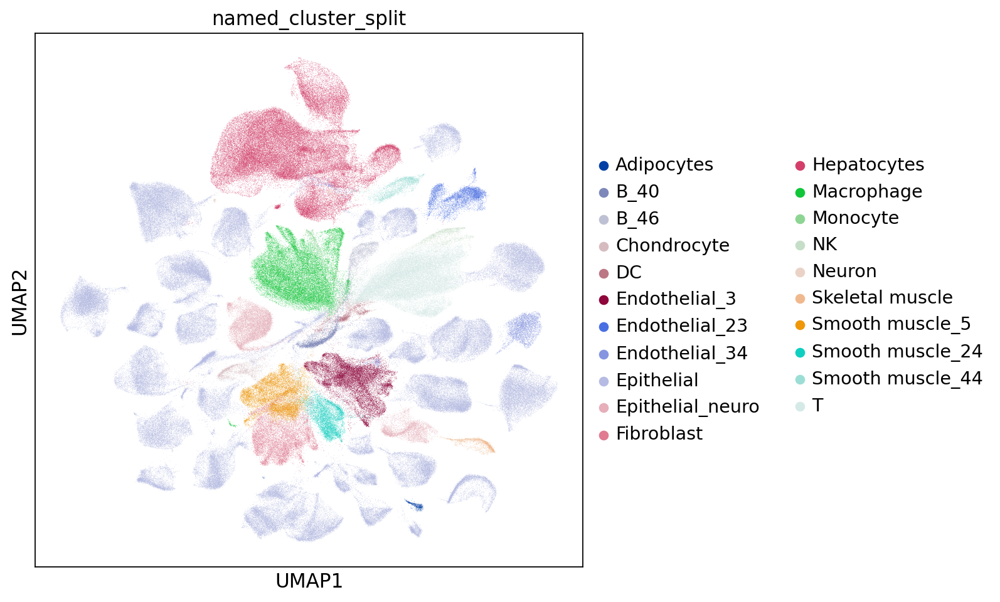

In [131]:
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata, color=['named_cluster_split'],legend_fontweight='normal')

In [136]:
#compartments
adata.obs['compartments']=adata.obs['labels_cl_unif2_broad'].map(lambda x: "Lymphoid" if x in ["T","B","NK"] else 
                                                                  ("Myeloid" if x in ["Macrophage","Monocyte","DC"] else 
                                                                   ("Stromal" if x in ["Smooth muscle","Chondrocyte","Hepatocytes","Fibroblast","Endothelial","Skeletal muscle","Adipocytes","Neuron"] else 
                                                                    ("Malignant" if x in ["Epithelial","Epithelial_neuro"] else x))))

#### select acceptable "misclassifications"

In [137]:
mix_df=pd.DataFrame(adata.obs.groupby('labels_cl_unif2')['labels_cl_unif'].value_counts(normalize=False).groupby('labels_cl_unif2').transform(lambda x: x/x.iloc[0]).rename('rat')).reset_index()

In [138]:
sel_combies=mix_df[mix_df.rat>0.4].copy()
sel_combies['concat']=sel_combies['labels_cl_unif2'].astype(str)+'_'+sel_combies['labels_cl_unif'].astype(str)
sel_combies['concat_rev']=sel_combies['labels_cl_unif'].astype(str)+'_'+sel_combies['labels_cl_unif2'].astype(str)
sel_combies[(sel_combies['labels_cl_unif2'].astype(str)!=sel_combies['labels_cl_unif'].astype(str))]

,labels_cl_unif2,labels_cl_unif,rat,concat,concat_rev
21,CD4+ T-cells,CD8+ T-cells,0.746846,CD4+ T-cells_CD8+ T-cells,CD8+ T-cells_CD4+ T-cells
38,Chondrocyte,Fibroblast,0.508197,Chondrocyte_Fibroblast,Fibroblast_Chondrocyte
143,NK,CD8+ T-cells,0.790289,NK_CD8+ T-cells,CD8+ T-cells_NK
165,Smooth muscle,Fibroblast,0.478758,Smooth muscle_Fibroblast,Fibroblast_Smooth muscle


#### Create subsetted objects

In [160]:
adata.obs['select_cell']=((adata.obs['concat'].astype('str').isin(sel_combies.concat.astype('str').append(sel_combies.concat_rev.astype('str'))
                                                                  .append(pd.Series(["Neurons_Mesangial cells","Neurons_Epithelial","Smooth muscle_Adipocytes","NK_CD4+ T-cells"])))) & (adata.obs['labels_cl_unif2']!="DC")) #remove DC because they are characterized by mito and low number of genes in the DE analysis

In [161]:
adata.obs.groupby('labels_cl_unif')['select_cell'].value_counts()

labels_cl_unif   select_cell
Adipocytes       True              980
                 False             754
B                True             5027
                 False              81
CD4+ T-cells     True            16289
                 False            2389
CD8+ T-cells     True            12902
                 False             563
Chondrocyte      False            4406
                 True             3027
DC               False            1360
Endothelial      True            28112
                 False            1539
Epithelial       True           189179
                 False            2025
Erythrocytes     False             314
Fibroblast       True            15605
                 False             817
HSC              False              53
Hepatocytes      True            66137
                 False            1499
Macrophage       True            27657
                 False            2218
Mesangial cells  True             1461
                 False             

In [162]:
#Check unexpected cnv status
ct_mal_counts=pd.DataFrame(adata.obs[adata.obs['select_cell']==True][['labels_cl_unif2','labels_cl_unif2_mal','cnv_pass_mal']].value_counts()).reset_index()
ct_mal_counts[((ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2_mal.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True")|(ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="False"))|((~ct_mal_counts.labels_cl_unif2.isin(mal_ct))&(ct_mal_counts.cnv_pass_mal=="True"))].sort_values(["cnv_pass_mal",0])

,labels_cl_unif2,labels_cl_unif2_mal,cnv_pass_mal,0
37,Epithelial,Skeletal muscle,False,2
35,Neurons,Smooth muscle,False,4
34,Epithelial,Fibroblast,False,5
33,Epithelial,Smooth muscle,False,6
29,Epithelial,CD4+ T-cells,False,13
26,Epithelial,Hepatocytes,False,28
23,Neurons,Neurons,False,78
22,Epithelial,Chondrocyte,False,138
17,Epithelial,Epithelial,False,208
36,Smooth muscle,Fibroblast,True,4


/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


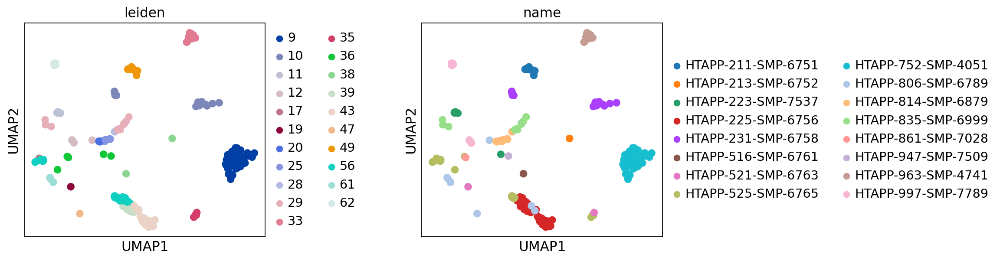

In [168]:
plt.rcParams['figure.figsize'] = [4, 4]
sc.pl.umap(adata[(adata.obs.select_cell==True)&((adata.obs.labels_cl_unif2.isin(mal_ct))|(adata.obs.labels_cl_unif2_mal.isin(mal_ct)))&(adata.obs.cnv_pass_mal=="False")].copy(), color=['leiden','name'],legend_fontweight='normal',wspace=0.5)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


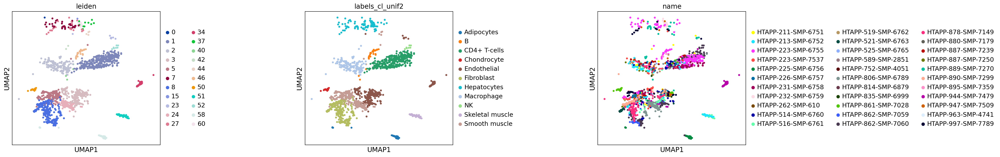

In [169]:
plt.rcParams['figure.figsize'] = [5, 5]
sc.pl.umap(adata[(adata.obs.select_cell==True)&((~adata.obs.labels_cl_unif2.isin(mal_ct))|(~adata.obs.labels_cl_unif2_mal.isin(mal_ct)))&(adata.obs.cnv_pass_mal=="True")].copy(), color=['leiden','labels_cl_unif2','name'],legend_fontweight='normal',wspace=0.8)

In [156]:
#remove all malignat cell types that don't pass cnv because they don't cluster together but split across many clusters and keep the "normal" cell types with cnv because they cluster according to cell type
adata.obs.loc[(adata.obs.select_cell==True)&((adata.obs.labels_cl_unif2.isin(mal_ct))|(adata.obs.labels_cl_unif2_mal.isin(mal_ct)))&(adata.obs.cnv_pass_mal=="False"),['select_cell']]=False

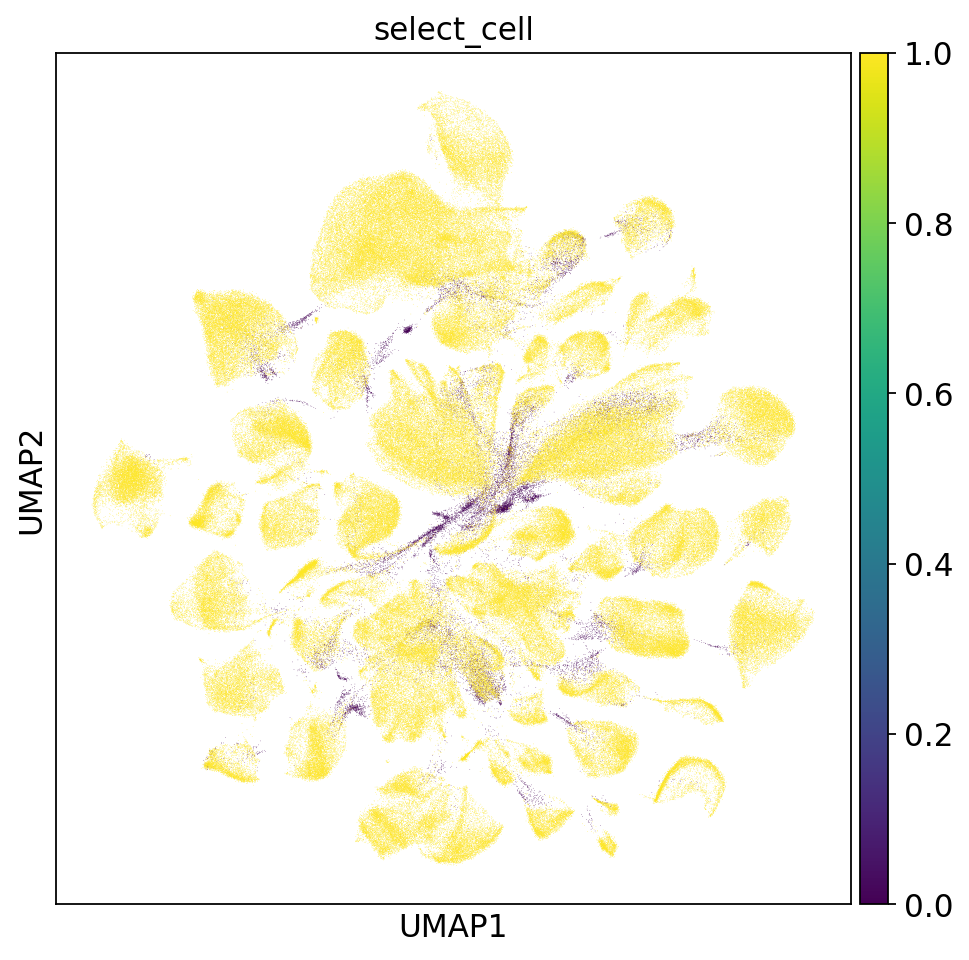

In [167]:
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata, color=['select_cell'],legend_fontweight='normal')

In [170]:
%%capture
adata.write(out_dir+"/"+cacheName+".h5ad",compression="gzip")

In [8]:
#adata=sc.read_h5ad(out_dir+"/"+cacheName+".h5ad")

In [171]:
adata_sel=adata[(adata.obs['select_cell']==True)]

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


#### Downsample

In [172]:
adata_sub=ini.downsample_to_smallest_category( adata_sel, 'named_cluster_split', min_cells=1000, keep_small_categories=True,random_state=42)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


### DE genes between cell types

#### Downsampled

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


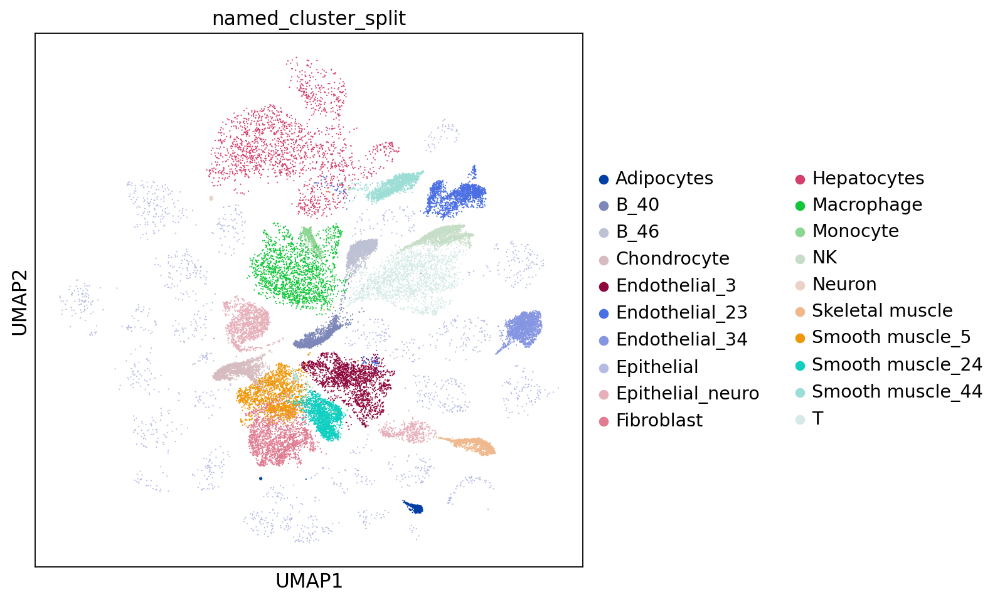

In [173]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sub, color=['named_cluster_split'])

In [174]:
sc.tl.rank_genes_groups(adata_sub, 'named_cluster_split', method='t-test_overestim_var',pts=True)

In [175]:
markers_sub={g:sc.get.rank_genes_groups_df(adata_sub, group=g)['names'][:5] for g in adata_sub.obs['named_cluster_split'].dtype.categories}

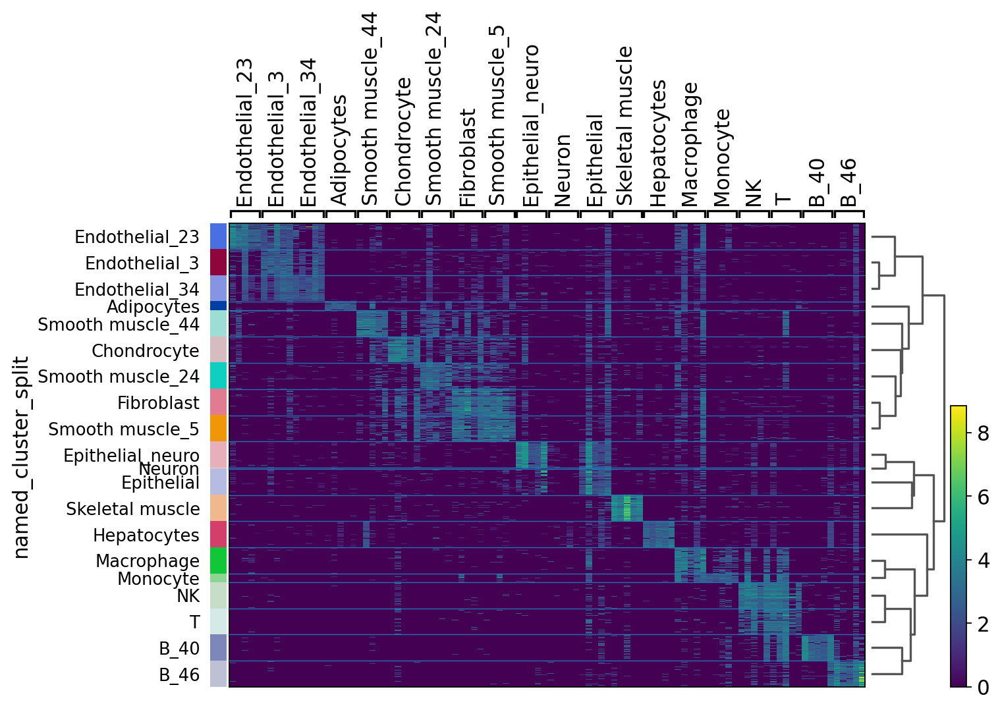

In [176]:
sc.tl.dendrogram(adata_sub,groupby='named_cluster_split')
sc.pl.heatmap(adata_sub, markers_sub, groupby='named_cluster_split', dendrogram=True)

Trying to set attribute `.uns` of view, copying.
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


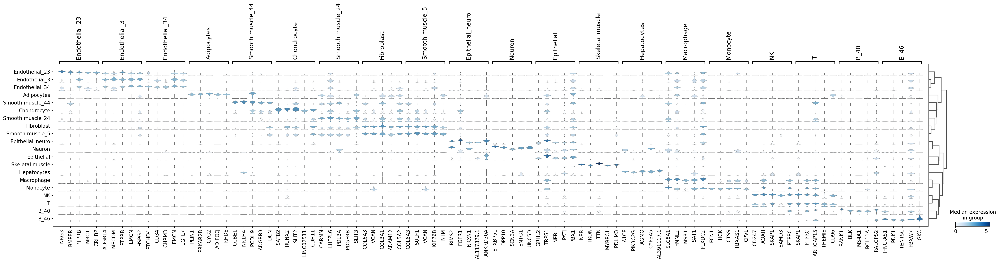

In [177]:
sc.tl.dendrogram(adata_sel,groupby='named_cluster_split')
sc.pl.stacked_violin(adata_sub,markers_sub, groupby='named_cluster_split', dendrogram=True)

#### Selected

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


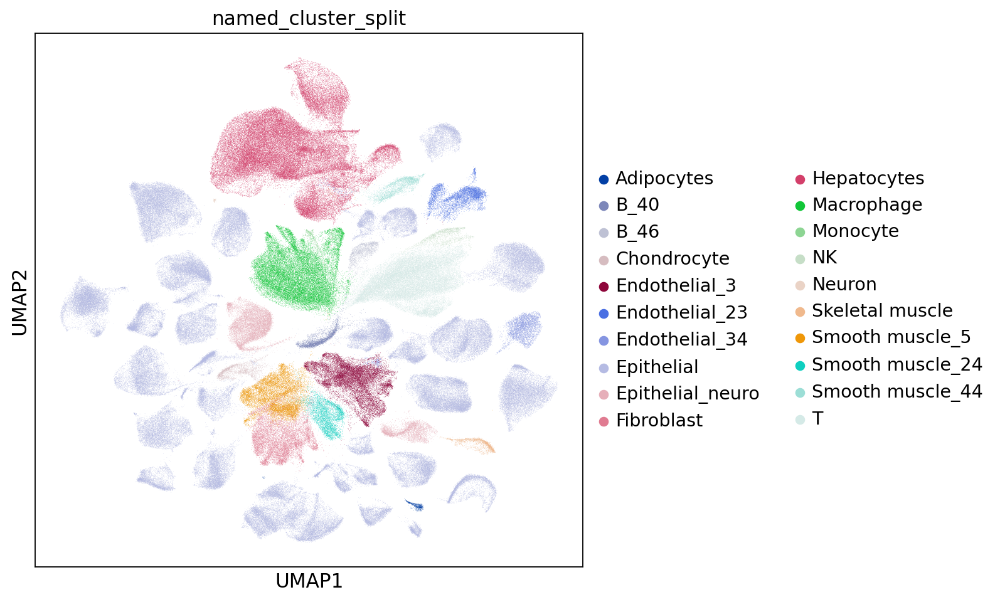

In [178]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['named_cluster_split'])

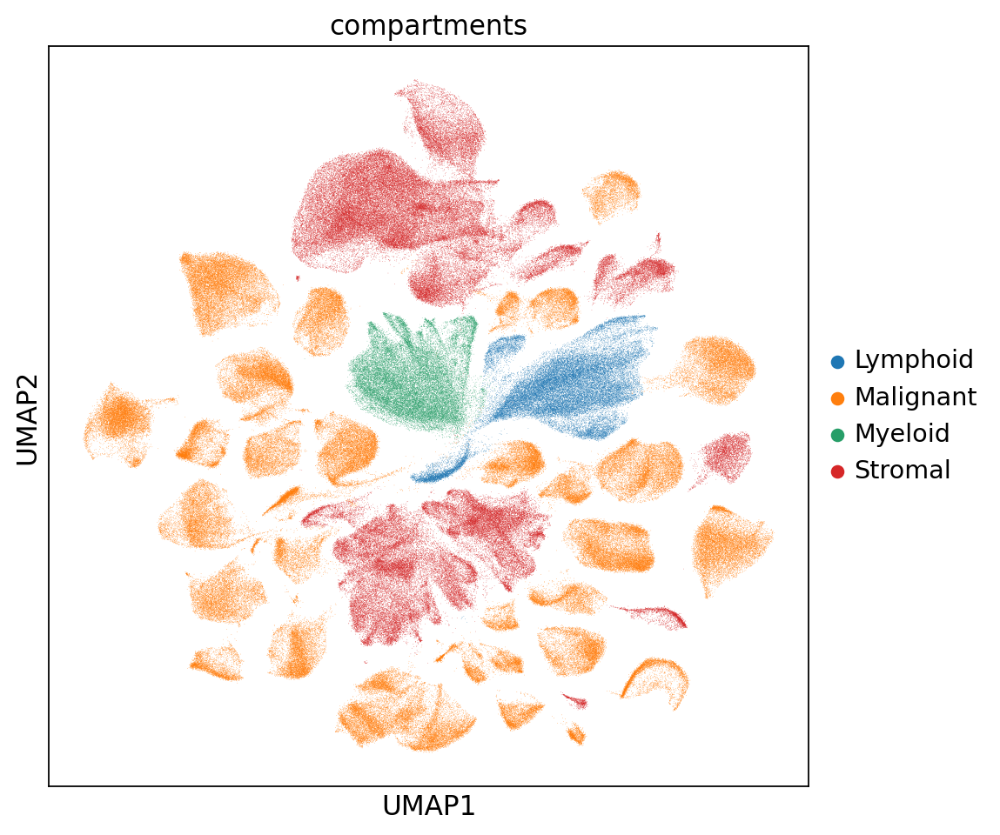

In [179]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['compartments'])

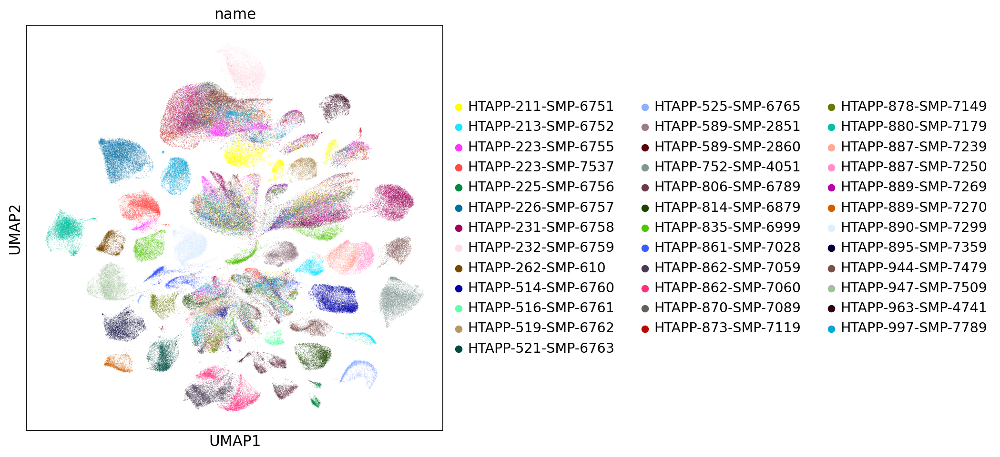

In [180]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['name'])

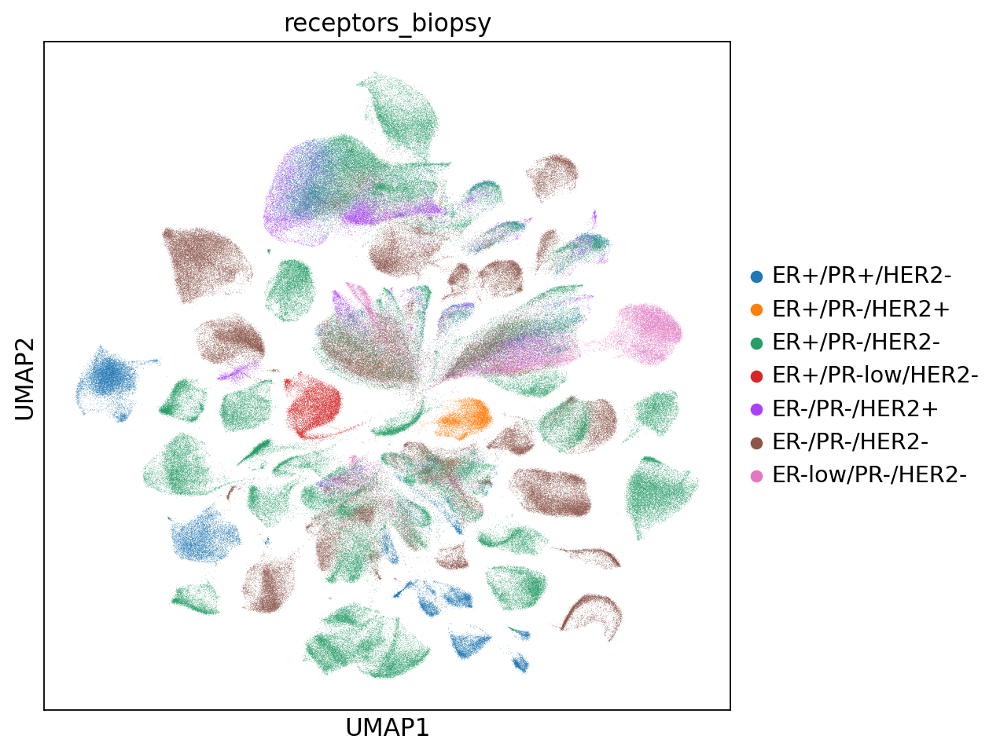

In [181]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['receptors_biopsy'])

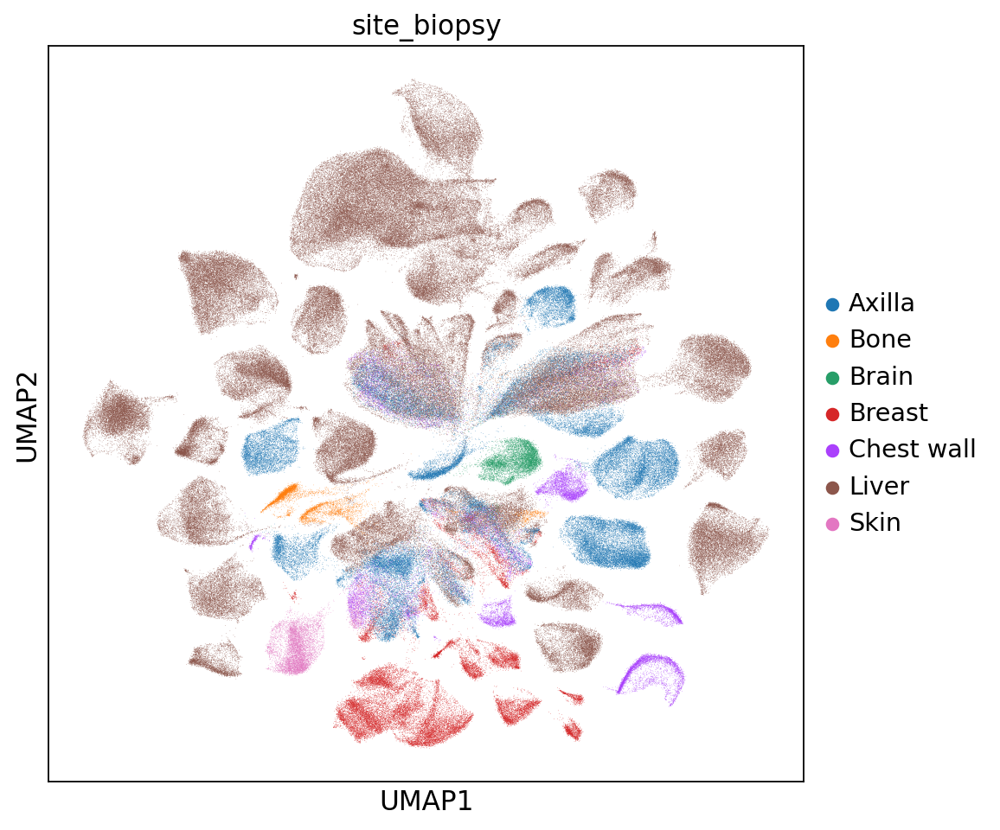

In [182]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
#del adata.uns['labels_colors']
sc.pl.umap(adata_sel, color=['site_biopsy'])

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


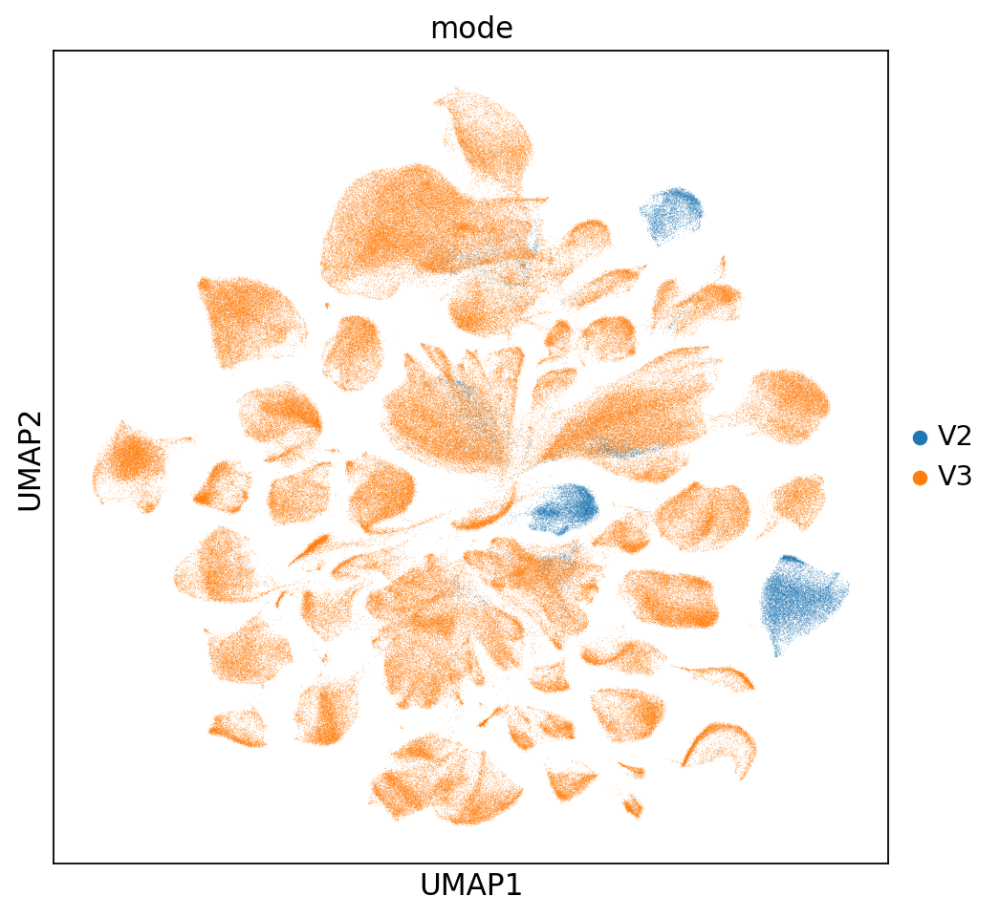

In [6]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata_sel, color=['mode'])

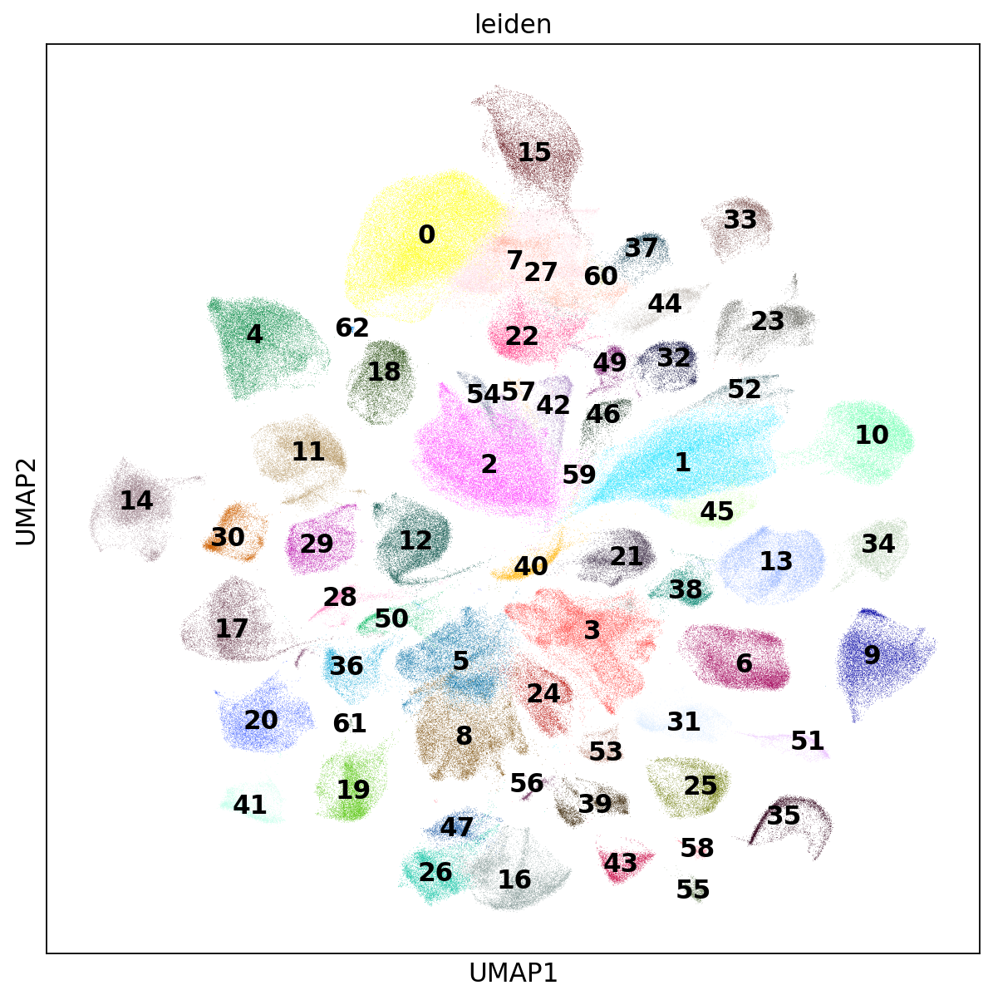

In [7]:
# standard params
plt.rcParams['figure.figsize'] = [9, 9]
sc.pl.umap(adata_sel, color=['leiden'],legend_loc='on data')

In [183]:
adata_sel.write(out_dir+"/"+cacheName+"_selected.h5ad",compression="gzip");

In [8]:
# adata_sel=sc.read_h5ad(out_dir+"/"+cacheName+"_selected.h5ad")

#### Stats

In [184]:
print(adata_sel.obs.nFeature_RNA.mean())
print(adata_sel.obs.nFeature_RNA.median())
print(len(adata_sel.obs.index))
print(len(adata_sel.obs.name.unique()))

2445.326194954047
2178.0
394534
37


#### DE analysis

In [185]:
sc.tl.rank_genes_groups(adata_sel, 'named_cluster_split', method='t-test_overestim_var',pts=True)

In [186]:
de_info=pd.concat([sc.get.rank_genes_groups_df(adata_sel, group=g)[:200].set_index('names').assign(pts=adata_sel.uns['rank_genes_groups']['pts'][g],pts_rest=adata_sel.uns['rank_genes_groups']['pts_rest'][g],type=g).reset_index() for g in adata_sel.obs['named_cluster_split'].unique()])
de_info=de_info.reset_index()
de_info.head()

,index,names,scores,logfoldchanges,pvals,pvals_adj,pts,pts_rest,type
0,0,GRHL2,1004.268372,5.208936,0.0,0.0,0.941257,0.081983,Epithelial
1,1,PBX1,761.334961,3.888410,0.0,0.0,0.987778,0.423649,Epithelial
2,2,TRPS1,717.908447,4.693527,0.0,0.0,0.969111,0.497011,Epithelial
3,3,NEBL,626.091248,4.000295,0.0,0.0,0.876373,0.165661,Epithelial
4,4,ESRP1,594.038513,4.891222,0.0,0.0,0.766467,0.056201,Epithelial


In [187]:
rest_thres=0.1

In [188]:
markers=de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names'][:5])
markers=dict(iter(markers.reset_index().groupby('type')['names']))

In [189]:
dedf=pd.DataFrame(de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names']))
dedf=dict(iter(dedf.reset_index().groupby('type')['names']))

In [190]:
dedf = pd.DataFrame({k: v.reset_index(drop=True) for k, v in dedf.items()})

In [191]:
dedf

,Adipocytes,B_40,B_46,Chondrocyte,Endothelial_23,Endothelial_3,Endothelial_34,Epithelial,Epithelial_neuro,Fibroblast,Hepatocytes,Macrophage,Monocyte,NK,Neuron,Skeletal muscle,Smooth muscle_24,Smooth muscle_44,Smooth muscle_5,T
0,PLIN1,BANK1,IFNG-AS1,SATB2,BMPER,PTPRB,PTCHD4,GRHL2,AC087623.2,COL6A3,A1CF,MSR1,FCN1,CD247,STXBP5L,NEB,CARMN,CCBE1,COL6A3,THEMIS
1,ADIPOQ,BLK,TENT5C,PRRX1,PTPRB,ADGRL4,EMCN,ESRP1,NRXN1,VCAN,AGMO,TFEC,HCK,SAMD3,SCN3A,TRDN,PDE3A,ADGRB3,VCAN,CD96
2,PTGER3,MS4A1,AC092546.1,LINC02511,MRC1,PECAM1,EGFL7,KRT19,GABRB3,COL3A1,CYP3A5,MERTK,POU2F2,CD96,UNC5D,TTN,PDGFRB,DCN,CDH11,RIPOR2
3,TMEM132C,PAX5,CD38,TEX41,CRHBP,CALCRL,PCDH17,KIAA1324,CTNNA2,COL1A2,AL391117.1,TBXAS1,CPVL,ITGAL,DPP10,PDLIM3,PDE1A,PDE1A,NTM,LINC01934
4,TRHDE,IKZF3,IGKC,FAT3,ST6GALNAC3,EMCN,CD34,VTCN1,RIMBP2,CDH11,APOB,NPL,IRAK3,SLFN12L,RIMBP2,MYBPC1,EDNRA,LAMA2,ADAMTS12,IKZF1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ALDH1A1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
140,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TMEM176B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
141,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ADORA2A-AS1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
142,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GREM2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [192]:
dedf.to_csv(de_dir + "/frozen_DE.tsv",sep="\t")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


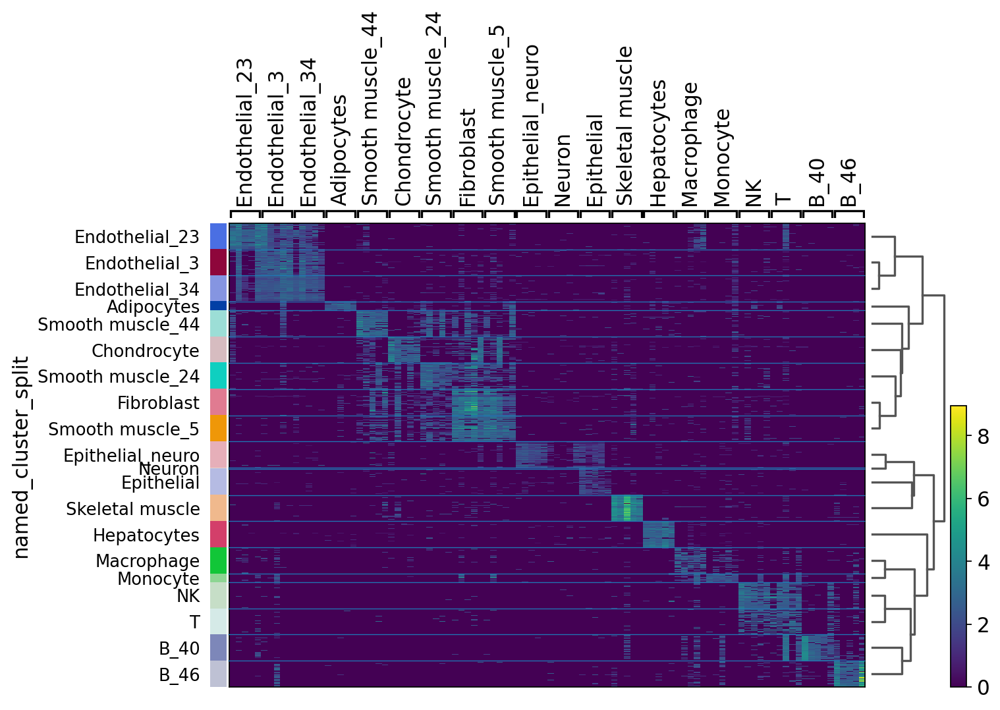

In [193]:
sc.tl.dendrogram(adata_sub,groupby='named_cluster_split')
sc.pl.heatmap(adata_sub, markers, groupby='named_cluster_split', dendrogram=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


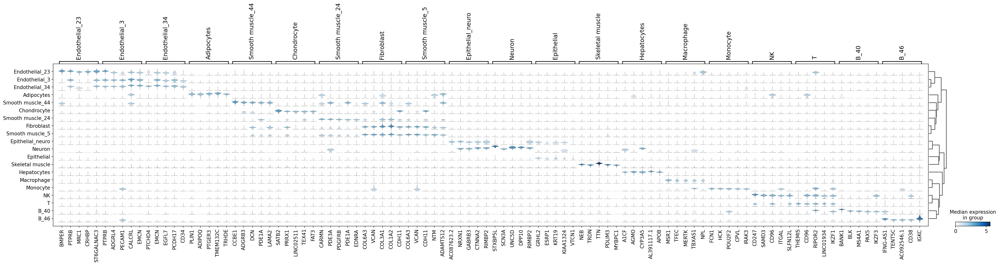

In [194]:
sc.pl.stacked_violin(adata_sel, markers, groupby='named_cluster_split', dendrogram=True)

#### Rename split clusters according to the DE analysis

In [197]:
types=['Endothelial_3','Endothelial_34']
get_sub_markers(adata_sel,types,key)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


type               
Endothelial_3   1           DPYD
                5          DACH1
                8         DPYSL3
                11         TMTC1
                14         UNC5B
                19         LMCD1
                26        IGFBP3
                33       ZNF385D
                35           MET
                37         NPAS2
Endothelial_34  202       COL8A1
                211         DPP6
                212     DNASE1L3
                229        ASIC2
                255        DOCK2
                257         APLN
                278    LINC01268
                287      FAM196B
                298         JPH1
                299        NR2F1
Name: names, dtype: object

In [198]:
types=['Endothelial_23','Endothelial_3','Endothelial_34']
get_sub_markers(adata_sel,types,key)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


type               
Endothelial_23  0           BMPER
                1           GATA4
                3           STAB2
                8            OIT3
                9            RELN
                13     AC092422.1
                14         ATRNL1
                16          ACSM3
                23           FCN3
                28            NPL
Endothelial_3   204         VEGFC
                214         RCAN2
                219       SIPA1L2
                220         UNC5B
                225         LMCD1
                227       ZNF385D
                238        IGFBP3
                241          STC1
                247           MET
                252         SGIP1
Endothelial_34  408          DPP6
                428         ASIC2
                440          APLN
                462     LINC01268
                463         DOCK2
                481          JPH1
                510    AC138305.1
                513         GRIA3
                518       FA

In [199]:
types=['Smooth muscle_5','Fibroblast']
get_sub_markers(adata_sel,types,key)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


type                
Fibroblast       204          FOXP2
                 205           EBF2
                 209           IGF1
                 210          MFAP5
                 214         PDZRN4
                 219           CILP
                 233          WISP2
                 237       ADAMTS17
                 244        ZNF385D
                 245    AADACL2-AS1
Smooth muscle_5  14           HMGA2
                 15            ANO4
                 19            NKD1
                 25         IGF2BP2
                 39       LINC01592
                 40          SLC4A4
                 68      AC105402.3
                 71            P3H2
                 76           SAMD5
                 81           RXFP1
Name: names, dtype: object

In [200]:
types=['Smooth muscle_44','Smooth muscle_24','Smooth muscle_5','Fibroblast']
get_sub_markers(adata_sel,types,key)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


type                 
Fibroblast        601         SFRP2
                  603         FOXP2
                  609          IGF1
                  610         MFAP5
                  620           BOC
                  625          CILP
                  628     LINC00578
                  630     BBOX1-AS1
                  648         WISP2
                  653       COLEC12
Smooth muscle_24  202          MCAM
                  204          RGS5
                  207          CDH6
                  209         TRPC6
                  219          GJC1
                  231      SLC38A11
                  247          GRM8
                  256         CSPG4
                  259         ITGA7
                  260         PDE1C
Smooth muscle_44  0           NR1H4
                  6           GNA14
                  8           GPM6A
                  13          MASP1
                  17           RELN
                  18          PTH1R
                  23          AGTR1
      

In [201]:
ct_dict={l:l for l in adata_sel.obs['named_cluster_split'].unique()}
ct_dict["Hepatocytes"]="Hepatocyte"
ct_dict["Epithelial"]="MBC"
ct_dict["Epithelial_neuro"]="MBC_neuronal"
ct_dict["B_46"]="B_plasma"
ct_dict["B_40"]="B"
ct_dict["Smooth muscle_44"]="Stellate"  #"Smooth muscle_lymphatic"
ct_dict["Smooth muscle_24"]="Smooth muscle_vascular"
ct_dict["Fibroblast"]="Fibroblast"  #"Myofibroblast"
ct_dict["Smooth muscle_5"]="Fibroblast"
ct_dict["Endothelial_34"]="Endothelial_angiogenic"
ct_dict["Endothelial_23"]="Endothelial_sinusoidal" #"Endothelial_lymphatic"
ct_dict["Endothelial_3"]="Endothelial_vascular"

In [205]:
adata_sel.obs['cell_type']=adata_sel.obs['named_cluster_split'].map(ct_dict)

In [209]:
adata_sel.obs['cell_type'].unique()

array(['MBC', 'Endothelial_vascular', 'Adipocytes', 'Fibroblast', 'T',
       'B_plasma', 'Macrophage', 'Smooth muscle_vascular', 'NK',
       'Endothelial_sinusoidal', 'Hepatocyte', 'Stellate', 'Monocyte',
       'B', 'Chondrocyte', 'MBC_neuronal', 'Endothelial_angiogenic',
       'Skeletal muscle', 'Neuron'], dtype=object)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
... storing 'cell_type' as categorical


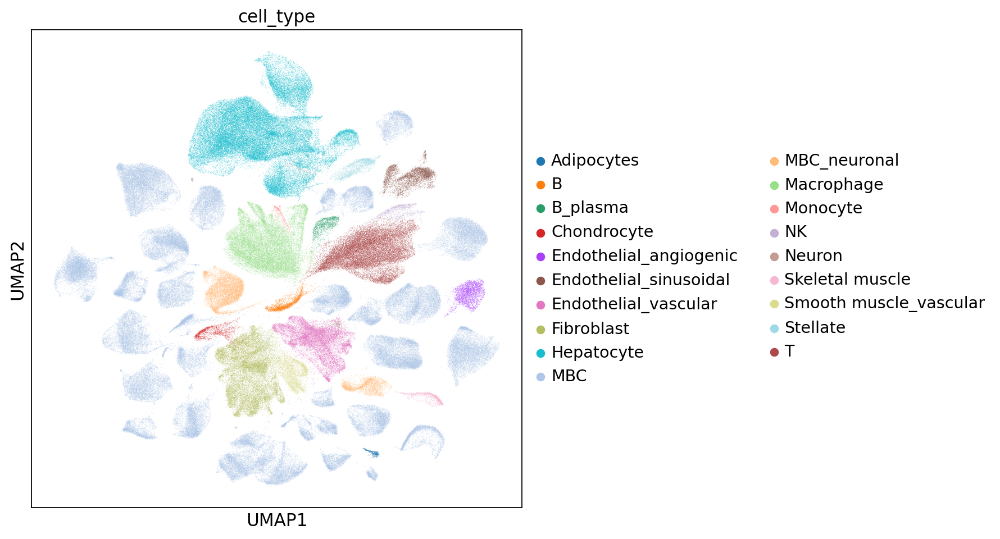

In [207]:
# standard params
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata_sel, color=['cell_type'])

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


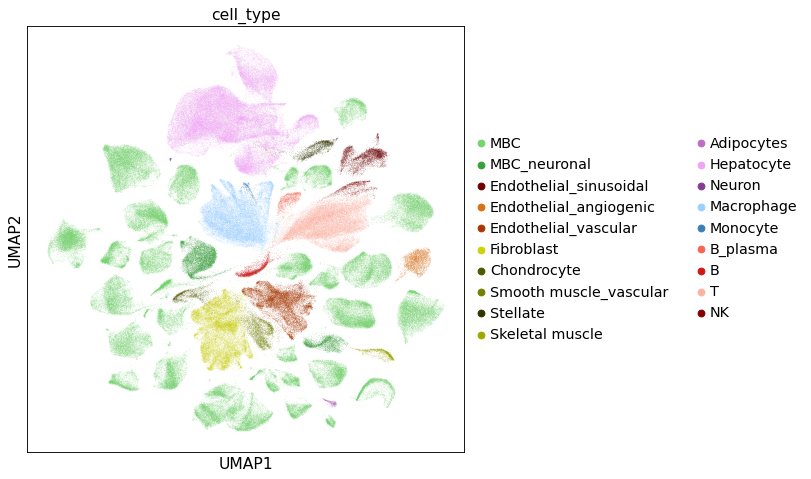

In [9]:
# standard params
sel_colors=colors[colors.index.isin(adata_sel.obs['cell_type'])]
adata_sel.obs['cell_type']=pd.Categorical(adata_sel.obs['cell_type'], categories=sel_colors.index)
plt.rcParams['figure.figsize'] = [7, 7]
fig=sc.pl.umap(adata_sel, color=['cell_type'],palette=sel_colors.values.tolist(),return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_ct"+".pdf",bbox_inches="tight")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


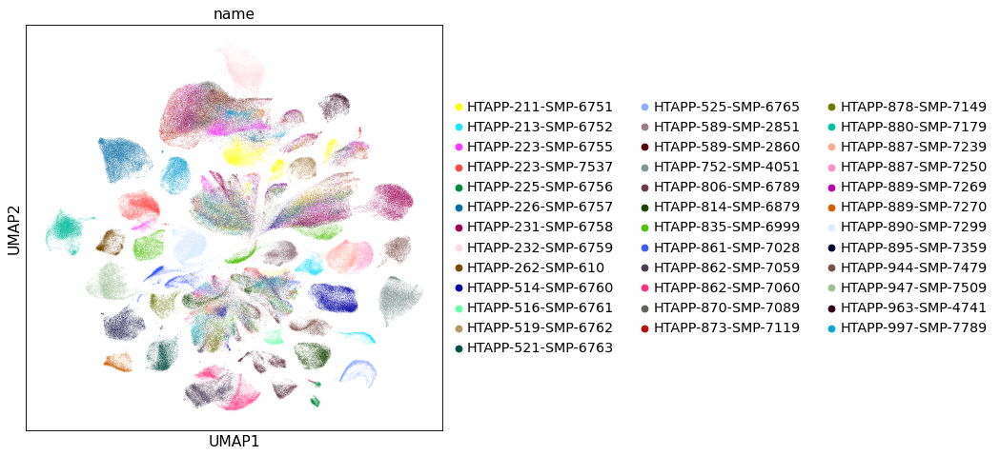

In [10]:
fig=sc.pl.umap(adata_sel, color=['name'],return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_name"+".pdf",bbox_inches="tight")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


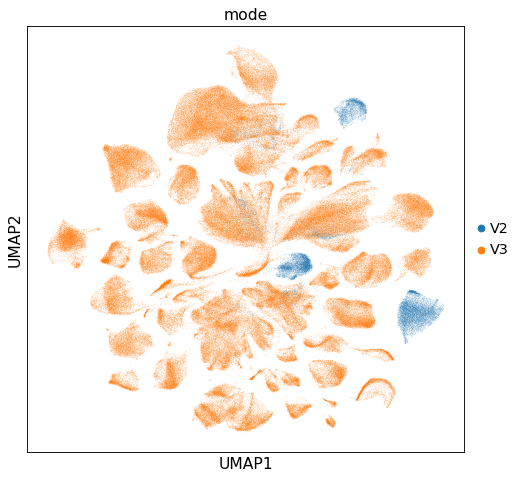

In [11]:
fig=sc.pl.umap(adata_sel, color=['mode'],return_fig=True)
fig.savefig(res_dir+cacheName+"_UMAP_mode"+".pdf",bbox_inches="tight")

In [210]:
adata_sel.write(out_dir+"/"+cacheName+"_selected.h5ad",compression="gzip");

In [6]:
adata_sel=sc.read_h5ad(out_dir+"/"+cacheName+"_selected.h5ad")

#### Check potential doublets

In [7]:
spath=baseDir+"/analysis/00_scrublet/all_scrublet.tsv"
scrub=pd.read_csv(spath,"\t")

In [8]:
scrub.drop(columns=["ident"],inplace=True)

In [9]:
new_obs=adata_sel.obs.merge(scrub,left_on='cell_id', right_on='cellid',how="left")

In [10]:
new_obs.set_index('cellid',inplace=True)
adata_sel.obs=new_obs

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1094: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead
/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


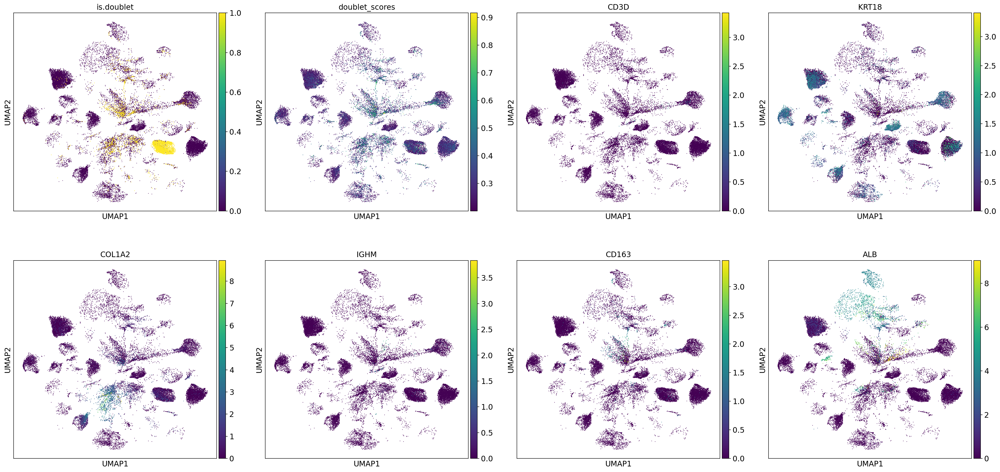

In [11]:
sel_colors=colors[colors.index.isin(adata_sel.obs['cell_type'])]
adata_sel.obs['cell_type']=pd.Categorical(adata_sel.obs['cell_type'], categories=sel_colors.index)
plt.rcParams['figure.figsize'] = [7, 7]
sc.pl.umap(adata_sel[adata_sel.obs['doublet_scores']>0.2], color=['is.doublet','doublet_scores',"CD3D","KRT18","COL1A2","IGHM","CD163","ALB"],palette=sel_colors.values.tolist())

#### DE analysis based on cell_type annotation

In [12]:
sc.tl.rank_genes_groups(adata_sel, 'cell_type', method='t-test_overestim_var',pts=True)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


In [13]:
de_info=pd.concat([sc.get.rank_genes_groups_df(adata_sel, group=g)[:200].set_index('names').assign(pts=adata_sel.uns['rank_genes_groups']['pts'][g],pts_rest=adata_sel.uns['rank_genes_groups']['pts_rest'][g],type=g).reset_index() for g in adata_sel.obs['cell_type'].unique()])
de_info=de_info.reset_index()
de_info.head()

,index,names,scores,logfoldchanges,pvals,pvals_adj,pct_nz_group,pct_nz_reference,pts,pts_rest,type
0,0,GRHL2,1004.268372,5.208936,0.0,0.0,0.941257,0.081983,0.941257,0.081983,MBC
1,1,PBX1,761.334961,3.888410,0.0,0.0,0.987778,0.423649,0.987778,0.423649,MBC
2,2,TRPS1,717.908447,4.693527,0.0,0.0,0.969111,0.497011,0.969111,0.497011,MBC
3,3,NEBL,626.091248,4.000295,0.0,0.0,0.876373,0.165661,0.876373,0.165661,MBC
4,4,ESRP1,594.038513,4.891222,0.0,0.0,0.766467,0.056201,0.766467,0.056201,MBC


In [14]:
rest_thres=0.1

In [15]:
markers=de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names'][:5])
markers=dict(iter(markers.reset_index().groupby('type')['names']))

In [11]:
dedf=pd.DataFrame(de_info[de_info.pts_rest<rest_thres].groupby('type').apply(lambda x: x['names']))
dedf=dict(iter(dedf.reset_index().groupby('type')['names']))

In [12]:
dedf = pd.DataFrame({k: v.reset_index(drop=True) for k, v in dedf.items()})

In [13]:
dedf

,Adipocytes,B,B_plasma,Chondrocyte,Endothelial_angiogenic,Endothelial_sinusoidal,Endothelial_vascular,Fibroblast,Hepatocyte,MBC,MBC_neuronal,Macrophage,Monocyte,NK,Neuron,Skeletal muscle,Smooth muscle_vascular,Stellate,T
0,PLIN1,BANK1,IFNG-AS1,SATB2,PTCHD4,BMPER,PTPRB,COL6A3,A1CF,GRHL2,AC087623.2,MSR1,FCN1,CD247,STXBP5L,NEB,CARMN,CCBE1,THEMIS
1,ADIPOQ,BLK,TENT5C,PRRX1,EMCN,PTPRB,ADGRL4,VCAN,AGMO,ESRP1,NRXN1,TFEC,HCK,SAMD3,SCN3A,TRDN,PDE3A,ADGRB3,CD96
2,PTGER3,MS4A1,AC092546.1,LINC02511,EGFL7,MRC1,PECAM1,CDH11,CYP3A5,KRT19,GABRB3,MERTK,POU2F2,CD96,UNC5D,TTN,PDGFRB,DCN,RIPOR2
3,TMEM132C,PAX5,CD38,TEX41,PCDH17,CRHBP,CALCRL,SULF1,AL391117.1,KIAA1324,CTNNA2,TBXAS1,CPVL,ITGAL,DPP10,PDLIM3,PDE1A,PDE1A,LINC01934
4,TRHDE,IKZF3,IGKC,FAT3,CD34,ST6GALNAC3,EMCN,COL1A2,APOB,VTCN1,RIMBP2,NPL,IRAK3,SLFN12L,RIMBP2,MYBPC1,EDNRA,LAMA2,IKZF1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
139,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ALDH1A1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
140,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,TMEM176B,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
141,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ADORA2A-AS1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
142,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,GREM2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [16]:
dedf.to_csv(de_dir + "/"+cacheName+"_cell_type_DE.tsv",sep="\t")

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


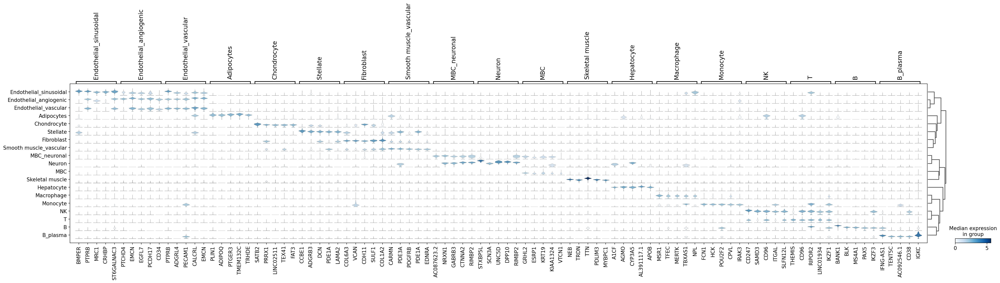

In [15]:
sc.pl.stacked_violin(adata_sel, markers, groupby='cell_type', dendrogram=True)

In [16]:
sc.tl.dendrogram(adata_sel,groupby='cell_type',var_names=markers,)

/secure/src/anaconda3/envs/scanpy/lib/python3.6/site-packages/anndata/_core/anndata.py:1192: FutureWarning: is_categorical is deprecated and will be removed in a future version.  Use is_categorical_dtype instead


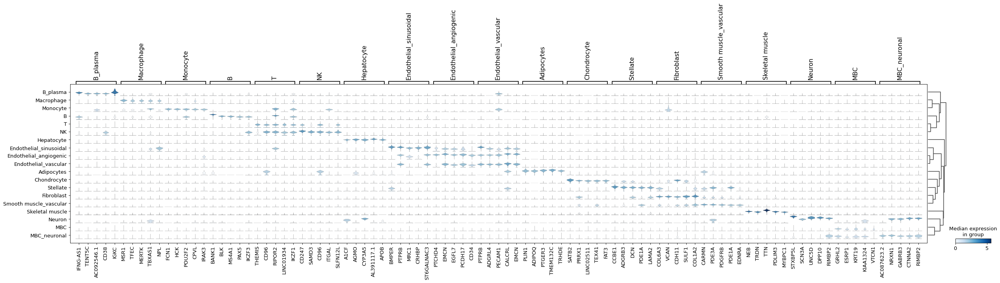

In [17]:
fig=sc.pl.stacked_violin(adata_sel, markers, groupby='cell_type', dendrogram=True,return_fig=True)
fig.savefig(res_dir+cacheName+"_DE"+".pdf",bbox_inches="tight")

#### Score a gene signature

In [11]:
hypoxia=["PGM2","GBE1","VLDLR","NR3C1","ISG20","SERPINE1","CDKN1A","TPST2","PPFIA4","CXCR4","GRHPR","SLC2A1","PYGM","PPP1R15A","AMPD3","KLF7","PAM","BCL2","ANKZF1","INHA","GPC1","HDLBP","PKP1","ATF3","PFKFB3","COL5A1","HSPA5","PDK1","TGM2","SDC4","PCK1","TPD52","CP","SIAH2","TIPARP","LXN","BCAN","PKLR","EFNA3","EFNA1","S100A4","SELENBP1","F3","CASP6","RRAGD","PNRC1","ALDOB","PLIN2","JUN","EDN2","SDC3","SLC2A5","ENO1","ERRFI1","B3GALT6","PPARGC1A","RBPJ","PGM1","IL6","FOSL2","HS3ST1","STBD1","CCNG2","PLAC8","SCARB1","PHKG1","SLC2A3","TES","KDM3A","HK2","CDKN1B","CAV1","NAGK","SLC6A6","BHLHE40","VHL","TPI1","ENO2","GAPDH","GYS1","LDHC","DPYSL4","PLAUR","ZFP36","GAPDHS","SULT2B1","LDHA","ADM","ALDOA","CDKN1C","IRS2","SAP30","NCAN","HMOX1","ETS1","RORA","ANXA2","SLC37A4","HEXA","TPBG","CHST2","GPC4","GPC3","TKTL1","ATP7A","SRPX","BRS3","IDS","BGN","PDK3","PGK1","FOXO3","AKAP12","HK1","PFKL","CSRP2","CITED2","TNFAIP3","P4HA1","DDIT4","CHST3","MIF","ILVBL","BTG1","DCN","KIF5A","DDIT3","EGFR","PRKCA","UGP2","GAA","PGAM2","GCK","IGFBP3","IGFBP1","STC2","P4HA2","ADORA2B","ENO3","ALDOC","WSB1","B4GALNT2","HOXB9","GALK1","JMJD6","PGF","FOS","TGFB3","GCNT2","MAP3K1","KLF6","PFKP","NFIL3","TGFBI","FBP1","GLRX","NDST2","BNIP3L","STC1","MYH9","SDC2","EXT1","NDRG1","MAFF","KDELR3","PDGFB","LALBA","FAM162A","TMEM45A","SLC25A1","KLHL24","HAS1","DUSP1","PIM1","ANGPTL4","IER3","VEGFA","DTNA","NEDD4L","LOX","NDST1","XPNPEP1","PRDX5","PPP1R3C","MXI1","AK4","MT2A","CA12","ZNF292","GPI","MT1E","NOCT","ACKR3","CCN1","ERO1A","CAVIN1","CCN2","LARGE1","CAVIN3","CCN5"]

In [18]:
sc.tl.score_genes(adata_sel,hypoxia,score_name="hypoxia_score",use_raw=True)

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt
fig, ax = plt.subplots(figsize=(20,7))
sns.boxplot(x="name", y="hypoxia_score", data=adata_sel.obs,ax=ax,order=adata_sel.obs.groupby('name')['hypoxia_score'].median().sort_values().index)
ax.set_xticklabels([l.get_text() for l in ax.get_xticklabels()], rotation=30,va='top',ha='right');
#ax.set_ylim([-0.25,0.75])
ax.set_axisbelow(True)
ax.plot([-0.5,len(ax.get_xticks())-0.5],[0,0],c='grey')

#### Compare to genes selected during probe selection (on only 6 samples)

In [9]:
sel_genes=pd.read_csv("/scratch/projects/HTAPP_MBC/phase1/analysis/00_spatial_probes/data_frozen_V3_ct.tsv",sep="\t")

In [ ]:
sc.tl.dendrogram(adata_sel,groupby='cell_type')
sc.pl.stacked_violin(adata_sel,list(sel_genes.gene), groupby='cell_type', dendrogram=True)